In [160]:
import os
import numpy as np
import cv2
import matplotlib.pyplot as plt
import matplotlib.animation as animation
%matplotlib inline
import shutil
from pathlib import Path
import pandas as pd
import torch
from torch.utils.data import TensorDataset,DataLoader
import torch.nn as nn
import torch.utils.data as utils
import torchvision.utils as vutils
import torchvision.transforms as transforms
from torchvision.datasets import ImageFolder
import torchvision.datasets as dsets
import torchvision.models as models
import torch.optim as optim
from IPython.display import HTML

In [2]:
%ls
#%mkdir images
root_path='C:\\Users\\Srinjay\\Desktop\\GAN\\data0\\lsun'

 Volume in drive C is Windows
 Volume Serial Number is 50BB-B218

 Directory of C:\Users\Srinjay\Desktop\GAN

07-10-2018  00:58    <DIR>          .
07-10-2018  00:58    <DIR>          ..
29-09-2018  20:57    <DIR>          .ipynb_checkpoints
29-09-2018  20:48    <DIR>          data0
07-10-2018  00:58        16,915,425 DCGAN_LSUN.ipynb
29-09-2018  20:16    <DIR>          images
04-10-2018  03:12     1,482,326,144 images_np_array.npy
06-10-2018  22:04                 0 None0000000.png
29-09-2018  02:59        11,181,450 Pascal Object detection.ipynb
               4 File(s)  1,510,423,019 bytes
               5 Dir(s)  21,516,345,344 bytes free


In [3]:
root_path1= Path(root_path)
all_images=root_path1/'images'
#dest=root_path1/'images'
img_path = root_path1/'bedroom'
csv_path = root_path1/'files.csv'
tmp_path = root_path1/'tmp'
tmp_path.mkdir(exist_ok=True)
files = root_path1.glob('bedroom/**/*.jpg')
#src=img_path
src='C:\\Users\\Srinjay\\Desktop\\GAN\\data0\\lsun\\images'
dest='C:\\Users\\Srinjay\\Desktop\\GAN\\data0\\lsun\\sampled_images'

In [4]:
def list_attr(obj):
    for attr in dir(obj):
        print ("obj.%s = attr.%s"%(obj,hasattr(obj,attr)))
list_attr(files)

obj.<generator object Path.glob at 0x000001CF65FCB2B0> = attr.True
obj.<generator object Path.glob at 0x000001CF65FCB2B0> = attr.True
obj.<generator object Path.glob at 0x000001CF65FCB2B0> = attr.True
obj.<generator object Path.glob at 0x000001CF65FCB2B0> = attr.True
obj.<generator object Path.glob at 0x000001CF65FCB2B0> = attr.True
obj.<generator object Path.glob at 0x000001CF65FCB2B0> = attr.True
obj.<generator object Path.glob at 0x000001CF65FCB2B0> = attr.True
obj.<generator object Path.glob at 0x000001CF65FCB2B0> = attr.True
obj.<generator object Path.glob at 0x000001CF65FCB2B0> = attr.True
obj.<generator object Path.glob at 0x000001CF65FCB2B0> = attr.True
obj.<generator object Path.glob at 0x000001CF65FCB2B0> = attr.True
obj.<generator object Path.glob at 0x000001CF65FCB2B0> = attr.True
obj.<generator object Path.glob at 0x000001CF65FCB2B0> = attr.True
obj.<generator object Path.glob at 0x000001CF65FCB2B0> = attr.True
obj.<generator object Path.glob at 0x000001CF65FCB2B0> = attr.

In [151]:
import random
src_files=os.listdir(src)
for (i,file_name) in enumerate(src_files):
    print (i)
    if random.random() < 0.5:
        full_name=os.path.join(src,file_name)
        shutil.copy(full_name,dest)

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
27

3498
3499
3500
3501
3502
3503
3504
3505
3506
3507
3508
3509
3510
3511
3512
3513
3514
3515
3516
3517
3518
3519
3520
3521
3522
3523
3524
3525
3526
3527
3528
3529
3530
3531
3532
3533
3534
3535
3536
3537
3538
3539
3540
3541
3542
3543
3544
3545
3546
3547
3548
3549
3550
3551
3552
3553
3554
3555
3556
3557
3558
3559
3560
3561
3562
3563
3564
3565
3566
3567
3568
3569
3570
3571
3572
3573
3574
3575
3576
3577
3578
3579
3580
3581
3582
3583
3584
3585
3586
3587
3588
3589
3590
3591
3592
3593
3594
3595
3596
3597
3598
3599
3600
3601
3602
3603
3604
3605
3606
3607
3608
3609
3610
3611
3612
3613
3614
3615
3616
3617
3618
3619
3620
3621
3622
3623
3624
3625
3626
3627
3628
3629
3630
3631
3632
3633
3634
3635
3636
3637
3638
3639
3640
3641
3642
3643
3644
3645
3646
3647
3648
3649
3650
3651
3652
3653
3654
3655
3656
3657
3658
3659
3660
3661
3662
3663
3664
3665
3666
3667
3668
3669
3670
3671
3672
3673
3674
3675
3676
3677
3678
3679
3680
3681
3682
3683
3684
3685
3686
3687
3688
3689
3690
3691
3692
3693
3694
3695
3696
3697


6774
6775
6776
6777
6778
6779
6780
6781
6782
6783
6784
6785
6786
6787
6788
6789
6790
6791
6792
6793
6794
6795
6796
6797
6798
6799
6800
6801
6802
6803
6804
6805
6806
6807
6808
6809
6810
6811
6812
6813
6814
6815
6816
6817
6818
6819
6820
6821
6822
6823
6824
6825
6826
6827
6828
6829
6830
6831
6832
6833
6834
6835
6836
6837
6838
6839
6840
6841
6842
6843
6844
6845
6846
6847
6848
6849
6850
6851
6852
6853
6854
6855
6856
6857
6858
6859
6860
6861
6862
6863
6864
6865
6866
6867
6868
6869
6870
6871
6872
6873
6874
6875
6876
6877
6878
6879
6880
6881
6882
6883
6884
6885
6886
6887
6888
6889
6890
6891
6892
6893
6894
6895
6896
6897
6898
6899
6900
6901
6902
6903
6904
6905
6906
6907
6908
6909
6910
6911
6912
6913
6914
6915
6916
6917
6918
6919
6920
6921
6922
6923
6924
6925
6926
6927
6928
6929
6930
6931
6932
6933
6934
6935
6936
6937
6938
6939
6940
6941
6942
6943
6944
6945
6946
6947
6948
6949
6950
6951
6952
6953
6954
6955
6956
6957
6958
6959
6960
6961
6962
6963
6964
6965
6966
6967
6968
6969
6970
6971
6972
6973


10042
10043
10044
10045
10046
10047
10048
10049
10050
10051
10052
10053
10054
10055
10056
10057
10058
10059
10060
10061
10062
10063
10064
10065
10066
10067
10068
10069
10070
10071
10072
10073
10074
10075
10076
10077
10078
10079
10080
10081
10082
10083
10084
10085
10086
10087
10088
10089
10090
10091
10092
10093
10094
10095
10096
10097
10098
10099
10100
10101
10102
10103
10104
10105
10106
10107
10108
10109
10110
10111
10112
10113
10114
10115
10116
10117
10118
10119
10120
10121
10122
10123
10124
10125
10126
10127
10128
10129
10130
10131
10132
10133
10134
10135
10136
10137
10138
10139
10140
10141
10142
10143
10144
10145
10146
10147
10148
10149
10150
10151
10152
10153
10154
10155
10156
10157
10158
10159
10160
10161
10162
10163
10164
10165
10166
10167
10168
10169
10170
10171
10172
10173
10174
10175
10176
10177
10178
10179
10180
10181
10182
10183
10184
10185
10186
10187
10188
10189
10190
10191
10192
10193
10194
10195
10196
10197
10198
10199
10200
10201
10202
10203
10204
10205
10206
10207
1020

12772
12773
12774
12775
12776
12777
12778
12779
12780
12781
12782
12783
12784
12785
12786
12787
12788
12789
12790
12791
12792
12793
12794
12795
12796
12797
12798
12799
12800
12801
12802
12803
12804
12805
12806
12807
12808
12809
12810
12811
12812
12813
12814
12815
12816
12817
12818
12819
12820
12821
12822
12823
12824
12825
12826
12827
12828
12829
12830
12831
12832
12833
12834
12835
12836
12837
12838
12839
12840
12841
12842
12843
12844
12845
12846
12847
12848
12849
12850
12851
12852
12853
12854
12855
12856
12857
12858
12859
12860
12861
12862
12863
12864
12865
12866
12867
12868
12869
12870
12871
12872
12873
12874
12875
12876
12877
12878
12879
12880
12881
12882
12883
12884
12885
12886
12887
12888
12889
12890
12891
12892
12893
12894
12895
12896
12897
12898
12899
12900
12901
12902
12903
12904
12905
12906
12907
12908
12909
12910
12911
12912
12913
12914
12915
12916
12917
12918
12919
12920
12921
12922
12923
12924
12925
12926
12927
12928
12929
12930
12931
12932
12933
12934
12935
12936
12937
1293

15502
15503
15504
15505
15506
15507
15508
15509
15510
15511
15512
15513
15514
15515
15516
15517
15518
15519
15520
15521
15522
15523
15524
15525
15526
15527
15528
15529
15530
15531
15532
15533
15534
15535
15536
15537
15538
15539
15540
15541
15542
15543
15544
15545
15546
15547
15548
15549
15550
15551
15552
15553
15554
15555
15556
15557
15558
15559
15560
15561
15562
15563
15564
15565
15566
15567
15568
15569
15570
15571
15572
15573
15574
15575
15576
15577
15578
15579
15580
15581
15582
15583
15584
15585
15586
15587
15588
15589
15590
15591
15592
15593
15594
15595
15596
15597
15598
15599
15600
15601
15602
15603
15604
15605
15606
15607
15608
15609
15610
15611
15612
15613
15614
15615
15616
15617
15618
15619
15620
15621
15622
15623
15624
15625
15626
15627
15628
15629
15630
15631
15632
15633
15634
15635
15636
15637
15638
15639
15640
15641
15642
15643
15644
15645
15646
15647
15648
15649
15650
15651
15652
15653
15654
15655
15656
15657
15658
15659
15660
15661
15662
15663
15664
15665
15666
15667
1566

18232
18233
18234
18235
18236
18237
18238
18239
18240
18241
18242
18243
18244
18245
18246
18247
18248
18249
18250
18251
18252
18253
18254
18255
18256
18257
18258
18259
18260
18261
18262
18263
18264
18265
18266
18267
18268
18269
18270
18271
18272
18273
18274
18275
18276
18277
18278
18279
18280
18281
18282
18283
18284
18285
18286
18287
18288
18289
18290
18291
18292
18293
18294
18295
18296
18297
18298
18299
18300
18301
18302
18303
18304
18305
18306
18307
18308
18309
18310
18311
18312
18313
18314
18315
18316
18317
18318
18319
18320
18321
18322
18323
18324
18325
18326
18327
18328
18329
18330
18331
18332
18333
18334
18335
18336
18337
18338
18339
18340
18341
18342
18343
18344
18345
18346
18347
18348
18349
18350
18351
18352
18353
18354
18355
18356
18357
18358
18359
18360
18361
18362
18363
18364
18365
18366
18367
18368
18369
18370
18371
18372
18373
18374
18375
18376
18377
18378
18379
18380
18381
18382
18383
18384
18385
18386
18387
18388
18389
18390
18391
18392
18393
18394
18395
18396
18397
1839

20962
20963
20964
20965
20966
20967
20968
20969
20970
20971
20972
20973
20974
20975
20976
20977
20978
20979
20980
20981
20982
20983
20984
20985
20986
20987
20988
20989
20990
20991
20992
20993
20994
20995
20996
20997
20998
20999
21000
21001
21002
21003
21004
21005
21006
21007
21008
21009
21010
21011
21012
21013
21014
21015
21016
21017
21018
21019
21020
21021
21022
21023
21024
21025
21026
21027
21028
21029
21030
21031
21032
21033
21034
21035
21036
21037
21038
21039
21040
21041
21042
21043
21044
21045
21046
21047
21048
21049
21050
21051
21052
21053
21054
21055
21056
21057
21058
21059
21060
21061
21062
21063
21064
21065
21066
21067
21068
21069
21070
21071
21072
21073
21074
21075
21076
21077
21078
21079
21080
21081
21082
21083
21084
21085
21086
21087
21088
21089
21090
21091
21092
21093
21094
21095
21096
21097
21098
21099
21100
21101
21102
21103
21104
21105
21106
21107
21108
21109
21110
21111
21112
21113
21114
21115
21116
21117
21118
21119
21120
21121
21122
21123
21124
21125
21126
21127
2112

23692
23693
23694
23695
23696
23697
23698
23699
23700
23701
23702
23703
23704
23705
23706
23707
23708
23709
23710
23711
23712
23713
23714
23715
23716
23717
23718
23719
23720
23721
23722
23723
23724
23725
23726
23727
23728
23729
23730
23731
23732
23733
23734
23735
23736
23737
23738
23739
23740
23741
23742
23743
23744
23745
23746
23747
23748
23749
23750
23751
23752
23753
23754
23755
23756
23757
23758
23759
23760
23761
23762
23763
23764
23765
23766
23767
23768
23769
23770
23771
23772
23773
23774
23775
23776
23777
23778
23779
23780
23781
23782
23783
23784
23785
23786
23787
23788
23789
23790
23791
23792
23793
23794
23795
23796
23797
23798
23799
23800
23801
23802
23803
23804
23805
23806
23807
23808
23809
23810
23811
23812
23813
23814
23815
23816
23817
23818
23819
23820
23821
23822
23823
23824
23825
23826
23827
23828
23829
23830
23831
23832
23833
23834
23835
23836
23837
23838
23839
23840
23841
23842
23843
23844
23845
23846
23847
23848
23849
23850
23851
23852
23853
23854
23855
23856
23857
2385

26422
26423
26424
26425
26426
26427
26428
26429
26430
26431
26432
26433
26434
26435
26436
26437
26438
26439
26440
26441
26442
26443
26444
26445
26446
26447
26448
26449
26450
26451
26452
26453
26454
26455
26456
26457
26458
26459
26460
26461
26462
26463
26464
26465
26466
26467
26468
26469
26470
26471
26472
26473
26474
26475
26476
26477
26478
26479
26480
26481
26482
26483
26484
26485
26486
26487
26488
26489
26490
26491
26492
26493
26494
26495
26496
26497
26498
26499
26500
26501
26502
26503
26504
26505
26506
26507
26508
26509
26510
26511
26512
26513
26514
26515
26516
26517
26518
26519
26520
26521
26522
26523
26524
26525
26526
26527
26528
26529
26530
26531
26532
26533
26534
26535
26536
26537
26538
26539
26540
26541
26542
26543
26544
26545
26546
26547
26548
26549
26550
26551
26552
26553
26554
26555
26556
26557
26558
26559
26560
26561
26562
26563
26564
26565
26566
26567
26568
26569
26570
26571
26572
26573
26574
26575
26576
26577
26578
26579
26580
26581
26582
26583
26584
26585
26586
26587
2658

29152
29153
29154
29155
29156
29157
29158
29159
29160
29161
29162
29163
29164
29165
29166
29167
29168
29169
29170
29171
29172
29173
29174
29175
29176
29177
29178
29179
29180
29181
29182
29183
29184
29185
29186
29187
29188
29189
29190
29191
29192
29193
29194
29195
29196
29197
29198
29199
29200
29201
29202
29203
29204
29205
29206
29207
29208
29209
29210
29211
29212
29213
29214
29215
29216
29217
29218
29219
29220
29221
29222
29223
29224
29225
29226
29227
29228
29229
29230
29231
29232
29233
29234
29235
29236
29237
29238
29239
29240
29241
29242
29243
29244
29245
29246
29247
29248
29249
29250
29251
29252
29253
29254
29255
29256
29257
29258
29259
29260
29261
29262
29263
29264
29265
29266
29267
29268
29269
29270
29271
29272
29273
29274
29275
29276
29277
29278
29279
29280
29281
29282
29283
29284
29285
29286
29287
29288
29289
29290
29291
29292
29293
29294
29295
29296
29297
29298
29299
29300
29301
29302
29303
29304
29305
29306
29307
29308
29309
29310
29311
29312
29313
29314
29315
29316
29317
2931

31882
31883
31884
31885
31886
31887
31888
31889
31890
31891
31892
31893
31894
31895
31896
31897
31898
31899
31900
31901
31902
31903
31904
31905
31906
31907
31908
31909
31910
31911
31912
31913
31914
31915
31916
31917
31918
31919
31920
31921
31922
31923
31924
31925
31926
31927
31928
31929
31930
31931
31932
31933
31934
31935
31936
31937
31938
31939
31940
31941
31942
31943
31944
31945
31946
31947
31948
31949
31950
31951
31952
31953
31954
31955
31956
31957
31958
31959
31960
31961
31962
31963
31964
31965
31966
31967
31968
31969
31970
31971
31972
31973
31974
31975
31976
31977
31978
31979
31980
31981
31982
31983
31984
31985
31986
31987
31988
31989
31990
31991
31992
31993
31994
31995
31996
31997
31998
31999
32000
32001
32002
32003
32004
32005
32006
32007
32008
32009
32010
32011
32012
32013
32014
32015
32016
32017
32018
32019
32020
32021
32022
32023
32024
32025
32026
32027
32028
32029
32030
32031
32032
32033
32034
32035
32036
32037
32038
32039
32040
32041
32042
32043
32044
32045
32046
32047
3204

34612
34613
34614
34615
34616
34617
34618
34619
34620
34621
34622
34623
34624
34625
34626
34627
34628
34629
34630
34631
34632
34633
34634
34635
34636
34637
34638
34639
34640
34641
34642
34643
34644
34645
34646
34647
34648
34649
34650
34651
34652
34653
34654
34655
34656
34657
34658
34659
34660
34661
34662
34663
34664
34665
34666
34667
34668
34669
34670
34671
34672
34673
34674
34675
34676
34677
34678
34679
34680
34681
34682
34683
34684
34685
34686
34687
34688
34689
34690
34691
34692
34693
34694
34695
34696
34697
34698
34699
34700
34701
34702
34703
34704
34705
34706
34707
34708
34709
34710
34711
34712
34713
34714
34715
34716
34717
34718
34719
34720
34721
34722
34723
34724
34725
34726
34727
34728
34729
34730
34731
34732
34733
34734
34735
34736
34737
34738
34739
34740
34741
34742
34743
34744
34745
34746
34747
34748
34749
34750
34751
34752
34753
34754
34755
34756
34757
34758
34759
34760
34761
34762
34763
34764
34765
34766
34767
34768
34769
34770
34771
34772
34773
34774
34775
34776
34777
3477

37342
37343
37344
37345
37346
37347
37348
37349
37350
37351
37352
37353
37354
37355
37356
37357
37358
37359
37360
37361
37362
37363
37364
37365
37366
37367
37368
37369
37370
37371
37372
37373
37374
37375
37376
37377
37378
37379
37380
37381
37382
37383
37384
37385
37386
37387
37388
37389
37390
37391
37392
37393
37394
37395
37396
37397
37398
37399
37400
37401
37402
37403
37404
37405
37406
37407
37408
37409
37410
37411
37412
37413
37414
37415
37416
37417
37418
37419
37420
37421
37422
37423
37424
37425
37426
37427
37428
37429
37430
37431
37432
37433
37434
37435
37436
37437
37438
37439
37440
37441
37442
37443
37444
37445
37446
37447
37448
37449
37450
37451
37452
37453
37454
37455
37456
37457
37458
37459
37460
37461
37462
37463
37464
37465
37466
37467
37468
37469
37470
37471
37472
37473
37474
37475
37476
37477
37478
37479
37480
37481
37482
37483
37484
37485
37486
37487
37488
37489
37490
37491
37492
37493
37494
37495
37496
37497
37498
37499
37500
37501
37502
37503
37504
37505
37506
37507
3750

40072
40073
40074
40075
40076
40077
40078
40079
40080
40081
40082
40083
40084
40085
40086
40087
40088
40089
40090
40091
40092
40093
40094
40095
40096
40097
40098
40099
40100
40101
40102
40103
40104
40105
40106
40107
40108
40109
40110
40111
40112
40113
40114
40115
40116
40117
40118
40119
40120
40121
40122
40123
40124
40125
40126
40127
40128
40129
40130
40131
40132
40133
40134
40135
40136
40137
40138
40139
40140
40141
40142
40143
40144
40145
40146
40147
40148
40149
40150
40151
40152
40153
40154
40155
40156
40157
40158
40159
40160
40161
40162
40163
40164
40165
40166
40167
40168
40169
40170
40171
40172
40173
40174
40175
40176
40177
40178
40179
40180
40181
40182
40183
40184
40185
40186
40187
40188
40189
40190
40191
40192
40193
40194
40195
40196
40197
40198
40199
40200
40201
40202
40203
40204
40205
40206
40207
40208
40209
40210
40211
40212
40213
40214
40215
40216
40217
40218
40219
40220
40221
40222
40223
40224
40225
40226
40227
40228
40229
40230
40231
40232
40233
40234
40235
40236
40237
4023

42802
42803
42804
42805
42806
42807
42808
42809
42810
42811
42812
42813
42814
42815
42816
42817
42818
42819
42820
42821
42822
42823
42824
42825
42826
42827
42828
42829
42830
42831
42832
42833
42834
42835
42836
42837
42838
42839
42840
42841
42842
42843
42844
42845
42846
42847
42848
42849
42850
42851
42852
42853
42854
42855
42856
42857
42858
42859
42860
42861
42862
42863
42864
42865
42866
42867
42868
42869
42870
42871
42872
42873
42874
42875
42876
42877
42878
42879
42880
42881
42882
42883
42884
42885
42886
42887
42888
42889
42890
42891
42892
42893
42894
42895
42896
42897
42898
42899
42900
42901
42902
42903
42904
42905
42906
42907
42908
42909
42910
42911
42912
42913
42914
42915
42916
42917
42918
42919
42920
42921
42922
42923
42924
42925
42926
42927
42928
42929
42930
42931
42932
42933
42934
42935
42936
42937
42938
42939
42940
42941
42942
42943
42944
42945
42946
42947
42948
42949
42950
42951
42952
42953
42954
42955
42956
42957
42958
42959
42960
42961
42962
42963
42964
42965
42966
42967
4296

45532
45533
45534
45535
45536
45537
45538
45539
45540
45541
45542
45543
45544
45545
45546
45547
45548
45549
45550
45551
45552
45553
45554
45555
45556
45557
45558
45559
45560
45561
45562
45563
45564
45565
45566
45567
45568
45569
45570
45571
45572
45573
45574
45575
45576
45577
45578
45579
45580
45581
45582
45583
45584
45585
45586
45587
45588
45589
45590
45591
45592
45593
45594
45595
45596
45597
45598
45599
45600
45601
45602
45603
45604
45605
45606
45607
45608
45609
45610
45611
45612
45613
45614
45615
45616
45617
45618
45619
45620
45621
45622
45623
45624
45625
45626
45627
45628
45629
45630
45631
45632
45633
45634
45635
45636
45637
45638
45639
45640
45641
45642
45643
45644
45645
45646
45647
45648
45649
45650
45651
45652
45653
45654
45655
45656
45657
45658
45659
45660
45661
45662
45663
45664
45665
45666
45667
45668
45669
45670
45671
45672
45673
45674
45675
45676
45677
45678
45679
45680
45681
45682
45683
45684
45685
45686
45687
45688
45689
45690
45691
45692
45693
45694
45695
45696
45697
4569

48262
48263
48264
48265
48266
48267
48268
48269
48270
48271
48272
48273
48274
48275
48276
48277
48278
48279
48280
48281
48282
48283
48284
48285
48286
48287
48288
48289
48290
48291
48292
48293
48294
48295
48296
48297
48298
48299
48300
48301
48302
48303
48304
48305
48306
48307
48308
48309
48310
48311
48312
48313
48314
48315
48316
48317
48318
48319
48320
48321
48322
48323
48324
48325
48326
48327
48328
48329
48330
48331
48332
48333
48334
48335
48336
48337
48338
48339
48340
48341
48342
48343
48344
48345
48346
48347
48348
48349
48350
48351
48352
48353
48354
48355
48356
48357
48358
48359
48360
48361
48362
48363
48364
48365
48366
48367
48368
48369
48370
48371
48372
48373
48374
48375
48376
48377
48378
48379
48380
48381
48382
48383
48384
48385
48386
48387
48388
48389
48390
48391
48392
48393
48394
48395
48396
48397
48398
48399
48400
48401
48402
48403
48404
48405
48406
48407
48408
48409
48410
48411
48412
48413
48414
48415
48416
48417
48418
48419
48420
48421
48422
48423
48424
48425
48426
48427
4842

50992
50993
50994
50995
50996
50997
50998
50999
51000
51001
51002
51003
51004
51005
51006
51007
51008
51009
51010
51011
51012
51013
51014
51015
51016
51017
51018
51019
51020
51021
51022
51023
51024
51025
51026
51027
51028
51029
51030
51031
51032
51033
51034
51035
51036
51037
51038
51039
51040
51041
51042
51043
51044
51045
51046
51047
51048
51049
51050
51051
51052
51053
51054
51055
51056
51057
51058
51059
51060
51061
51062
51063
51064
51065
51066
51067
51068
51069
51070
51071
51072
51073
51074
51075
51076
51077
51078
51079
51080
51081
51082
51083
51084
51085
51086
51087
51088
51089
51090
51091
51092
51093
51094
51095
51096
51097
51098
51099
51100
51101
51102
51103
51104
51105
51106
51107
51108
51109
51110
51111
51112
51113
51114
51115
51116
51117
51118
51119
51120
51121
51122
51123
51124
51125
51126
51127
51128
51129
51130
51131
51132
51133
51134
51135
51136
51137
51138
51139
51140
51141
51142
51143
51144
51145
51146
51147
51148
51149
51150
51151
51152
51153
51154
51155
51156
51157
5115

53722
53723
53724
53725
53726
53727
53728
53729
53730
53731
53732
53733
53734
53735
53736
53737
53738
53739
53740
53741
53742
53743
53744
53745
53746
53747
53748
53749
53750
53751
53752
53753
53754
53755
53756
53757
53758
53759
53760
53761
53762
53763
53764
53765
53766
53767
53768
53769
53770
53771
53772
53773
53774
53775
53776
53777
53778
53779
53780
53781
53782
53783
53784
53785
53786
53787
53788
53789
53790
53791
53792
53793
53794
53795
53796
53797
53798
53799
53800
53801
53802
53803
53804
53805
53806
53807
53808
53809
53810
53811
53812
53813
53814
53815
53816
53817
53818
53819
53820
53821
53822
53823
53824
53825
53826
53827
53828
53829
53830
53831
53832
53833
53834
53835
53836
53837
53838
53839
53840
53841
53842
53843
53844
53845
53846
53847
53848
53849
53850
53851
53852
53853
53854
53855
53856
53857
53858
53859
53860
53861
53862
53863
53864
53865
53866
53867
53868
53869
53870
53871
53872
53873
53874
53875
53876
53877
53878
53879
53880
53881
53882
53883
53884
53885
53886
53887
5388

56452
56453
56454
56455
56456
56457
56458
56459
56460
56461
56462
56463
56464
56465
56466
56467
56468
56469
56470
56471
56472
56473
56474
56475
56476
56477
56478
56479
56480
56481
56482
56483
56484
56485
56486
56487
56488
56489
56490
56491
56492
56493
56494
56495
56496
56497
56498
56499
56500
56501
56502
56503
56504
56505
56506
56507
56508
56509
56510
56511
56512
56513
56514
56515
56516
56517
56518
56519
56520
56521
56522
56523
56524
56525
56526
56527
56528
56529
56530
56531
56532
56533
56534
56535
56536
56537
56538
56539
56540
56541
56542
56543
56544
56545
56546
56547
56548
56549
56550
56551
56552
56553
56554
56555
56556
56557
56558
56559
56560
56561
56562
56563
56564
56565
56566
56567
56568
56569
56570
56571
56572
56573
56574
56575
56576
56577
56578
56579
56580
56581
56582
56583
56584
56585
56586
56587
56588
56589
56590
56591
56592
56593
56594
56595
56596
56597
56598
56599
56600
56601
56602
56603
56604
56605
56606
56607
56608
56609
56610
56611
56612
56613
56614
56615
56616
56617
5661

59182
59183
59184
59185
59186
59187
59188
59189
59190
59191
59192
59193
59194
59195
59196
59197
59198
59199
59200
59201
59202
59203
59204
59205
59206
59207
59208
59209
59210
59211
59212
59213
59214
59215
59216
59217
59218
59219
59220
59221
59222
59223
59224
59225
59226
59227
59228
59229
59230
59231
59232
59233
59234
59235
59236
59237
59238
59239
59240
59241
59242
59243
59244
59245
59246
59247
59248
59249
59250
59251
59252
59253
59254
59255
59256
59257
59258
59259
59260
59261
59262
59263
59264
59265
59266
59267
59268
59269
59270
59271
59272
59273
59274
59275
59276
59277
59278
59279
59280
59281
59282
59283
59284
59285
59286
59287
59288
59289
59290
59291
59292
59293
59294
59295
59296
59297
59298
59299
59300
59301
59302
59303
59304
59305
59306
59307
59308
59309
59310
59311
59312
59313
59314
59315
59316
59317
59318
59319
59320
59321
59322
59323
59324
59325
59326
59327
59328
59329
59330
59331
59332
59333
59334
59335
59336
59337
59338
59339
59340
59341
59342
59343
59344
59345
59346
59347
5934

61912
61913
61914
61915
61916
61917
61918
61919
61920
61921
61922
61923
61924
61925
61926
61927
61928
61929
61930
61931
61932
61933
61934
61935
61936
61937
61938
61939
61940
61941
61942
61943
61944
61945
61946
61947
61948
61949
61950
61951
61952
61953
61954
61955
61956
61957
61958
61959
61960
61961
61962
61963
61964
61965
61966
61967
61968
61969
61970
61971
61972
61973
61974
61975
61976
61977
61978
61979
61980
61981
61982
61983
61984
61985
61986
61987
61988
61989
61990
61991
61992
61993
61994
61995
61996
61997
61998
61999
62000
62001
62002
62003
62004
62005
62006
62007
62008
62009
62010
62011
62012
62013
62014
62015
62016
62017
62018
62019
62020
62021
62022
62023
62024
62025
62026
62027
62028
62029
62030
62031
62032
62033
62034
62035
62036
62037
62038
62039
62040
62041
62042
62043
62044
62045
62046
62047
62048
62049
62050
62051
62052
62053
62054
62055
62056
62057
62058
62059
62060
62061
62062
62063
62064
62065
62066
62067
62068
62069
62070
62071
62072
62073
62074
62075
62076
62077
6207

64642
64643
64644
64645
64646
64647
64648
64649
64650
64651
64652
64653
64654
64655
64656
64657
64658
64659
64660
64661
64662
64663
64664
64665
64666
64667
64668
64669
64670
64671
64672
64673
64674
64675
64676
64677
64678
64679
64680
64681
64682
64683
64684
64685
64686
64687
64688
64689
64690
64691
64692
64693
64694
64695
64696
64697
64698
64699
64700
64701
64702
64703
64704
64705
64706
64707
64708
64709
64710
64711
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
64722
64723
64724
64725
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64751
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64764
64765
64766
64767
64768
64769
64770
64771
64772
64773
64774
64775
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64786
64787
64788
64789
64790
64791
64792
64793
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64805
64806
64807
6480

67372
67373
67374
67375
67376
67377
67378
67379
67380
67381
67382
67383
67384
67385
67386
67387
67388
67389
67390
67391
67392
67393
67394
67395
67396
67397
67398
67399
67400
67401
67402
67403
67404
67405
67406
67407
67408
67409
67410
67411
67412
67413
67414
67415
67416
67417
67418
67419
67420
67421
67422
67423
67424
67425
67426
67427
67428
67429
67430
67431
67432
67433
67434
67435
67436
67437
67438
67439
67440
67441
67442
67443
67444
67445
67446
67447
67448
67449
67450
67451
67452
67453
67454
67455
67456
67457
67458
67459
67460
67461
67462
67463
67464
67465
67466
67467
67468
67469
67470
67471
67472
67473
67474
67475
67476
67477
67478
67479
67480
67481
67482
67483
67484
67485
67486
67487
67488
67489
67490
67491
67492
67493
67494
67495
67496
67497
67498
67499
67500
67501
67502
67503
67504
67505
67506
67507
67508
67509
67510
67511
67512
67513
67514
67515
67516
67517
67518
67519
67520
67521
67522
67523
67524
67525
67526
67527
67528
67529
67530
67531
67532
67533
67534
67535
67536
67537
6753

70102
70103
70104
70105
70106
70107
70108
70109
70110
70111
70112
70113
70114
70115
70116
70117
70118
70119
70120
70121
70122
70123
70124
70125
70126
70127
70128
70129
70130
70131
70132
70133
70134
70135
70136
70137
70138
70139
70140
70141
70142
70143
70144
70145
70146
70147
70148
70149
70150
70151
70152
70153
70154
70155
70156
70157
70158
70159
70160
70161
70162
70163
70164
70165
70166
70167
70168
70169
70170
70171
70172
70173
70174
70175
70176
70177
70178
70179
70180
70181
70182
70183
70184
70185
70186
70187
70188
70189
70190
70191
70192
70193
70194
70195
70196
70197
70198
70199
70200
70201
70202
70203
70204
70205
70206
70207
70208
70209
70210
70211
70212
70213
70214
70215
70216
70217
70218
70219
70220
70221
70222
70223
70224
70225
70226
70227
70228
70229
70230
70231
70232
70233
70234
70235
70236
70237
70238
70239
70240
70241
70242
70243
70244
70245
70246
70247
70248
70249
70250
70251
70252
70253
70254
70255
70256
70257
70258
70259
70260
70261
70262
70263
70264
70265
70266
70267
7026

72832
72833
72834
72835
72836
72837
72838
72839
72840
72841
72842
72843
72844
72845
72846
72847
72848
72849
72850
72851
72852
72853
72854
72855
72856
72857
72858
72859
72860
72861
72862
72863
72864
72865
72866
72867
72868
72869
72870
72871
72872
72873
72874
72875
72876
72877
72878
72879
72880
72881
72882
72883
72884
72885
72886
72887
72888
72889
72890
72891
72892
72893
72894
72895
72896
72897
72898
72899
72900
72901
72902
72903
72904
72905
72906
72907
72908
72909
72910
72911
72912
72913
72914
72915
72916
72917
72918
72919
72920
72921
72922
72923
72924
72925
72926
72927
72928
72929
72930
72931
72932
72933
72934
72935
72936
72937
72938
72939
72940
72941
72942
72943
72944
72945
72946
72947
72948
72949
72950
72951
72952
72953
72954
72955
72956
72957
72958
72959
72960
72961
72962
72963
72964
72965
72966
72967
72968
72969
72970
72971
72972
72973
72974
72975
72976
72977
72978
72979
72980
72981
72982
72983
72984
72985
72986
72987
72988
72989
72990
72991
72992
72993
72994
72995
72996
72997
7299

75562
75563
75564
75565
75566
75567
75568
75569
75570
75571
75572
75573
75574
75575
75576
75577
75578
75579
75580
75581
75582
75583
75584
75585
75586
75587
75588
75589
75590
75591
75592
75593
75594
75595
75596
75597
75598
75599
75600
75601
75602
75603
75604
75605
75606
75607
75608
75609
75610
75611
75612
75613
75614
75615
75616
75617
75618
75619
75620
75621
75622
75623
75624
75625
75626
75627
75628
75629
75630
75631
75632
75633
75634
75635
75636
75637
75638
75639
75640
75641
75642
75643
75644
75645
75646
75647
75648
75649
75650
75651
75652
75653
75654
75655
75656
75657
75658
75659
75660
75661
75662
75663
75664
75665
75666
75667
75668
75669
75670
75671
75672
75673
75674
75675
75676
75677
75678
75679
75680
75681
75682
75683
75684
75685
75686
75687
75688
75689
75690
75691
75692
75693
75694
75695
75696
75697
75698
75699
75700
75701
75702
75703
75704
75705
75706
75707
75708
75709
75710
75711
75712
75713
75714
75715
75716
75717
75718
75719
75720
75721
75722
75723
75724
75725
75726
75727
7572

78292
78293
78294
78295
78296
78297
78298
78299
78300
78301
78302
78303
78304
78305
78306
78307
78308
78309
78310
78311
78312
78313
78314
78315
78316
78317
78318
78319
78320
78321
78322
78323
78324
78325
78326
78327
78328
78329
78330
78331
78332
78333
78334
78335
78336
78337
78338
78339
78340
78341
78342
78343
78344
78345
78346
78347
78348
78349
78350
78351
78352
78353
78354
78355
78356
78357
78358
78359
78360
78361
78362
78363
78364
78365
78366
78367
78368
78369
78370
78371
78372
78373
78374
78375
78376
78377
78378
78379
78380
78381
78382
78383
78384
78385
78386
78387
78388
78389
78390
78391
78392
78393
78394
78395
78396
78397
78398
78399
78400
78401
78402
78403
78404
78405
78406
78407
78408
78409
78410
78411
78412
78413
78414
78415
78416
78417
78418
78419
78420
78421
78422
78423
78424
78425
78426
78427
78428
78429
78430
78431
78432
78433
78434
78435
78436
78437
78438
78439
78440
78441
78442
78443
78444
78445
78446
78447
78448
78449
78450
78451
78452
78453
78454
78455
78456
78457
7845

81022
81023
81024
81025
81026
81027
81028
81029
81030
81031
81032
81033
81034
81035
81036
81037
81038
81039
81040
81041
81042
81043
81044
81045
81046
81047
81048
81049
81050
81051
81052
81053
81054
81055
81056
81057
81058
81059
81060
81061
81062
81063
81064
81065
81066
81067
81068
81069
81070
81071
81072
81073
81074
81075
81076
81077
81078
81079
81080
81081
81082
81083
81084
81085
81086
81087
81088
81089
81090
81091
81092
81093
81094
81095
81096
81097
81098
81099
81100
81101
81102
81103
81104
81105
81106
81107
81108
81109
81110
81111
81112
81113
81114
81115
81116
81117
81118
81119
81120
81121
81122
81123
81124
81125
81126
81127
81128
81129
81130
81131
81132
81133
81134
81135
81136
81137
81138
81139
81140
81141
81142
81143
81144
81145
81146
81147
81148
81149
81150
81151
81152
81153
81154
81155
81156
81157
81158
81159
81160
81161
81162
81163
81164
81165
81166
81167
81168
81169
81170
81171
81172
81173
81174
81175
81176
81177
81178
81179
81180
81181
81182
81183
81184
81185
81186
81187
8118

83752
83753
83754
83755
83756
83757
83758
83759
83760
83761
83762
83763
83764
83765
83766
83767
83768
83769
83770
83771
83772
83773
83774
83775
83776
83777
83778
83779
83780
83781
83782
83783
83784
83785
83786
83787
83788
83789
83790
83791
83792
83793
83794
83795
83796
83797
83798
83799
83800
83801
83802
83803
83804
83805
83806
83807
83808
83809
83810
83811
83812
83813
83814
83815
83816
83817
83818
83819
83820
83821
83822
83823
83824
83825
83826
83827
83828
83829
83830
83831
83832
83833
83834
83835
83836
83837
83838
83839
83840
83841
83842
83843
83844
83845
83846
83847
83848
83849
83850
83851
83852
83853
83854
83855
83856
83857
83858
83859
83860
83861
83862
83863
83864
83865
83866
83867
83868
83869
83870
83871
83872
83873
83874
83875
83876
83877
83878
83879
83880
83881
83882
83883
83884
83885
83886
83887
83888
83889
83890
83891
83892
83893
83894
83895
83896
83897
83898
83899
83900
83901
83902
83903
83904
83905
83906
83907
83908
83909
83910
83911
83912
83913
83914
83915
83916
83917
8391

86482
86483
86484
86485
86486
86487
86488
86489
86490
86491
86492
86493
86494
86495
86496
86497
86498
86499
86500
86501
86502
86503
86504
86505
86506
86507
86508
86509
86510
86511
86512
86513
86514
86515
86516
86517
86518
86519
86520
86521
86522
86523
86524
86525
86526
86527
86528
86529
86530
86531
86532
86533
86534
86535
86536
86537
86538
86539
86540
86541
86542
86543
86544
86545
86546
86547
86548
86549
86550
86551
86552
86553
86554
86555
86556
86557
86558
86559
86560
86561
86562
86563
86564
86565
86566
86567
86568
86569
86570
86571
86572
86573
86574
86575
86576
86577
86578
86579
86580
86581
86582
86583
86584
86585
86586
86587
86588
86589
86590
86591
86592
86593
86594
86595
86596
86597
86598
86599
86600
86601
86602
86603
86604
86605
86606
86607
86608
86609
86610
86611
86612
86613
86614
86615
86616
86617
86618
86619
86620
86621
86622
86623
86624
86625
86626
86627
86628
86629
86630
86631
86632
86633
86634
86635
86636
86637
86638
86639
86640
86641
86642
86643
86644
86645
86646
86647
8664

89212
89213
89214
89215
89216
89217
89218
89219
89220
89221
89222
89223
89224
89225
89226
89227
89228
89229
89230
89231
89232
89233
89234
89235
89236
89237
89238
89239
89240
89241
89242
89243
89244
89245
89246
89247
89248
89249
89250
89251
89252
89253
89254
89255
89256
89257
89258
89259
89260
89261
89262
89263
89264
89265
89266
89267
89268
89269
89270
89271
89272
89273
89274
89275
89276
89277
89278
89279
89280
89281
89282
89283
89284
89285
89286
89287
89288
89289
89290
89291
89292
89293
89294
89295
89296
89297
89298
89299
89300
89301
89302
89303
89304
89305
89306
89307
89308
89309
89310
89311
89312
89313
89314
89315
89316
89317
89318
89319
89320
89321
89322
89323
89324
89325
89326
89327
89328
89329
89330
89331
89332
89333
89334
89335
89336
89337
89338
89339
89340
89341
89342
89343
89344
89345
89346
89347
89348
89349
89350
89351
89352
89353
89354
89355
89356
89357
89358
89359
89360
89361
89362
89363
89364
89365
89366
89367
89368
89369
89370
89371
89372
89373
89374
89375
89376
89377
8937

91942
91943
91944
91945
91946
91947
91948
91949
91950
91951
91952
91953
91954
91955
91956
91957
91958
91959
91960
91961
91962
91963
91964
91965
91966
91967
91968
91969
91970
91971
91972
91973
91974
91975
91976
91977
91978
91979
91980
91981
91982
91983
91984
91985
91986
91987
91988
91989
91990
91991
91992
91993
91994
91995
91996
91997
91998
91999
92000
92001
92002
92003
92004
92005
92006
92007
92008
92009
92010
92011
92012
92013
92014
92015
92016
92017
92018
92019
92020
92021
92022
92023
92024
92025
92026
92027
92028
92029
92030
92031
92032
92033
92034
92035
92036
92037
92038
92039
92040
92041
92042
92043
92044
92045
92046
92047
92048
92049
92050
92051
92052
92053
92054
92055
92056
92057
92058
92059
92060
92061
92062
92063
92064
92065
92066
92067
92068
92069
92070
92071
92072
92073
92074
92075
92076
92077
92078
92079
92080
92081
92082
92083
92084
92085
92086
92087
92088
92089
92090
92091
92092
92093
92094
92095
92096
92097
92098
92099
92100
92101
92102
92103
92104
92105
92106
92107
9210

94672
94673
94674
94675
94676
94677
94678
94679
94680
94681
94682
94683
94684
94685
94686
94687
94688
94689
94690
94691
94692
94693
94694
94695
94696
94697
94698
94699
94700
94701
94702
94703
94704
94705
94706
94707
94708
94709
94710
94711
94712
94713
94714
94715
94716
94717
94718
94719
94720
94721
94722
94723
94724
94725
94726
94727
94728
94729
94730
94731
94732
94733
94734
94735
94736
94737
94738
94739
94740
94741
94742
94743
94744
94745
94746
94747
94748
94749
94750
94751
94752
94753
94754
94755
94756
94757
94758
94759
94760
94761
94762
94763
94764
94765
94766
94767
94768
94769
94770
94771
94772
94773
94774
94775
94776
94777
94778
94779
94780
94781
94782
94783
94784
94785
94786
94787
94788
94789
94790
94791
94792
94793
94794
94795
94796
94797
94798
94799
94800
94801
94802
94803
94804
94805
94806
94807
94808
94809
94810
94811
94812
94813
94814
94815
94816
94817
94818
94819
94820
94821
94822
94823
94824
94825
94826
94827
94828
94829
94830
94831
94832
94833
94834
94835
94836
94837
9483

97402
97403
97404
97405
97406
97407
97408
97409
97410
97411
97412
97413
97414
97415
97416
97417
97418
97419
97420
97421
97422
97423
97424
97425
97426
97427
97428
97429
97430
97431
97432
97433
97434
97435
97436
97437
97438
97439
97440
97441
97442
97443
97444
97445
97446
97447
97448
97449
97450
97451
97452
97453
97454
97455
97456
97457
97458
97459
97460
97461
97462
97463
97464
97465
97466
97467
97468
97469
97470
97471
97472
97473
97474
97475
97476
97477
97478
97479
97480
97481
97482
97483
97484
97485
97486
97487
97488
97489
97490
97491
97492
97493
97494
97495
97496
97497
97498
97499
97500
97501
97502
97503
97504
97505
97506
97507
97508
97509
97510
97511
97512
97513
97514
97515
97516
97517
97518
97519
97520
97521
97522
97523
97524
97525
97526
97527
97528
97529
97530
97531
97532
97533
97534
97535
97536
97537
97538
97539
97540
97541
97542
97543
97544
97545
97546
97547
97548
97549
97550
97551
97552
97553
97554
97555
97556
97557
97558
97559
97560
97561
97562
97563
97564
97565
97566
97567
9756

100113
100114
100115
100116
100117
100118
100119
100120
100121
100122
100123
100124
100125
100126
100127
100128
100129
100130
100131
100132
100133
100134
100135
100136
100137
100138
100139
100140
100141
100142
100143
100144
100145
100146
100147
100148
100149
100150
100151
100152
100153
100154
100155
100156
100157
100158
100159
100160
100161
100162
100163
100164
100165
100166
100167
100168
100169
100170
100171
100172
100173
100174
100175
100176
100177
100178
100179
100180
100181
100182
100183
100184
100185
100186
100187
100188
100189
100190
100191
100192
100193
100194
100195
100196
100197
100198
100199
100200
100201
100202
100203
100204
100205
100206
100207
100208
100209
100210
100211
100212
100213
100214
100215
100216
100217
100218
100219
100220
100221
100222
100223
100224
100225
100226
100227
100228
100229
100230
100231
100232
100233
100234
100235
100236
100237
100238
100239
100240
100241
100242
100243
100244
100245
100246
100247
100248
100249
100250
100251
100252
100253
100254
100255

102453
102454
102455
102456
102457
102458
102459
102460
102461
102462
102463
102464
102465
102466
102467
102468
102469
102470
102471
102472
102473
102474
102475
102476
102477
102478
102479
102480
102481
102482
102483
102484
102485
102486
102487
102488
102489
102490
102491
102492
102493
102494
102495
102496
102497
102498
102499
102500
102501
102502
102503
102504
102505
102506
102507
102508
102509
102510
102511
102512
102513
102514
102515
102516
102517
102518
102519
102520
102521
102522
102523
102524
102525
102526
102527
102528
102529
102530
102531
102532
102533
102534
102535
102536
102537
102538
102539
102540
102541
102542
102543
102544
102545
102546
102547
102548
102549
102550
102551
102552
102553
102554
102555
102556
102557
102558
102559
102560
102561
102562
102563
102564
102565
102566
102567
102568
102569
102570
102571
102572
102573
102574
102575
102576
102577
102578
102579
102580
102581
102582
102583
102584
102585
102586
102587
102588
102589
102590
102591
102592
102593
102594
102595

104793
104794
104795
104796
104797
104798
104799
104800
104801
104802
104803
104804
104805
104806
104807
104808
104809
104810
104811
104812
104813
104814
104815
104816
104817
104818
104819
104820
104821
104822
104823
104824
104825
104826
104827
104828
104829
104830
104831
104832
104833
104834
104835
104836
104837
104838
104839
104840
104841
104842
104843
104844
104845
104846
104847
104848
104849
104850
104851
104852
104853
104854
104855
104856
104857
104858
104859
104860
104861
104862
104863
104864
104865
104866
104867
104868
104869
104870
104871
104872
104873
104874
104875
104876
104877
104878
104879
104880
104881
104882
104883
104884
104885
104886
104887
104888
104889
104890
104891
104892
104893
104894
104895
104896
104897
104898
104899
104900
104901
104902
104903
104904
104905
104906
104907
104908
104909
104910
104911
104912
104913
104914
104915
104916
104917
104918
104919
104920
104921
104922
104923
104924
104925
104926
104927
104928
104929
104930
104931
104932
104933
104934
104935

107133
107134
107135
107136
107137
107138
107139
107140
107141
107142
107143
107144
107145
107146
107147
107148
107149
107150
107151
107152
107153
107154
107155
107156
107157
107158
107159
107160
107161
107162
107163
107164
107165
107166
107167
107168
107169
107170
107171
107172
107173
107174
107175
107176
107177
107178
107179
107180
107181
107182
107183
107184
107185
107186
107187
107188
107189
107190
107191
107192
107193
107194
107195
107196
107197
107198
107199
107200
107201
107202
107203
107204
107205
107206
107207
107208
107209
107210
107211
107212
107213
107214
107215
107216
107217
107218
107219
107220
107221
107222
107223
107224
107225
107226
107227
107228
107229
107230
107231
107232
107233
107234
107235
107236
107237
107238
107239
107240
107241
107242
107243
107244
107245
107246
107247
107248
107249
107250
107251
107252
107253
107254
107255
107256
107257
107258
107259
107260
107261
107262
107263
107264
107265
107266
107267
107268
107269
107270
107271
107272
107273
107274
107275

109473
109474
109475
109476
109477
109478
109479
109480
109481
109482
109483
109484
109485
109486
109487
109488
109489
109490
109491
109492
109493
109494
109495
109496
109497
109498
109499
109500
109501
109502
109503
109504
109505
109506
109507
109508
109509
109510
109511
109512
109513
109514
109515
109516
109517
109518
109519
109520
109521
109522
109523
109524
109525
109526
109527
109528
109529
109530
109531
109532
109533
109534
109535
109536
109537
109538
109539
109540
109541
109542
109543
109544
109545
109546
109547
109548
109549
109550
109551
109552
109553
109554
109555
109556
109557
109558
109559
109560
109561
109562
109563
109564
109565
109566
109567
109568
109569
109570
109571
109572
109573
109574
109575
109576
109577
109578
109579
109580
109581
109582
109583
109584
109585
109586
109587
109588
109589
109590
109591
109592
109593
109594
109595
109596
109597
109598
109599
109600
109601
109602
109603
109604
109605
109606
109607
109608
109609
109610
109611
109612
109613
109614
109615

111813
111814
111815
111816
111817
111818
111819
111820
111821
111822
111823
111824
111825
111826
111827
111828
111829
111830
111831
111832
111833
111834
111835
111836
111837
111838
111839
111840
111841
111842
111843
111844
111845
111846
111847
111848
111849
111850
111851
111852
111853
111854
111855
111856
111857
111858
111859
111860
111861
111862
111863
111864
111865
111866
111867
111868
111869
111870
111871
111872
111873
111874
111875
111876
111877
111878
111879
111880
111881
111882
111883
111884
111885
111886
111887
111888
111889
111890
111891
111892
111893
111894
111895
111896
111897
111898
111899
111900
111901
111902
111903
111904
111905
111906
111907
111908
111909
111910
111911
111912
111913
111914
111915
111916
111917
111918
111919
111920
111921
111922
111923
111924
111925
111926
111927
111928
111929
111930
111931
111932
111933
111934
111935
111936
111937
111938
111939
111940
111941
111942
111943
111944
111945
111946
111947
111948
111949
111950
111951
111952
111953
111954
111955

114153
114154
114155
114156
114157
114158
114159
114160
114161
114162
114163
114164
114165
114166
114167
114168
114169
114170
114171
114172
114173
114174
114175
114176
114177
114178
114179
114180
114181
114182
114183
114184
114185
114186
114187
114188
114189
114190
114191
114192
114193
114194
114195
114196
114197
114198
114199
114200
114201
114202
114203
114204
114205
114206
114207
114208
114209
114210
114211
114212
114213
114214
114215
114216
114217
114218
114219
114220
114221
114222
114223
114224
114225
114226
114227
114228
114229
114230
114231
114232
114233
114234
114235
114236
114237
114238
114239
114240
114241
114242
114243
114244
114245
114246
114247
114248
114249
114250
114251
114252
114253
114254
114255
114256
114257
114258
114259
114260
114261
114262
114263
114264
114265
114266
114267
114268
114269
114270
114271
114272
114273
114274
114275
114276
114277
114278
114279
114280
114281
114282
114283
114284
114285
114286
114287
114288
114289
114290
114291
114292
114293
114294
114295

116493
116494
116495
116496
116497
116498
116499
116500
116501
116502
116503
116504
116505
116506
116507
116508
116509
116510
116511
116512
116513
116514
116515
116516
116517
116518
116519
116520
116521
116522
116523
116524
116525
116526
116527
116528
116529
116530
116531
116532
116533
116534
116535
116536
116537
116538
116539
116540
116541
116542
116543
116544
116545
116546
116547
116548
116549
116550
116551
116552
116553
116554
116555
116556
116557
116558
116559
116560
116561
116562
116563
116564
116565
116566
116567
116568
116569
116570
116571
116572
116573
116574
116575
116576
116577
116578
116579
116580
116581
116582
116583
116584
116585
116586
116587
116588
116589
116590
116591
116592
116593
116594
116595
116596
116597
116598
116599
116600
116601
116602
116603
116604
116605
116606
116607
116608
116609
116610
116611
116612
116613
116614
116615
116616
116617
116618
116619
116620
116621
116622
116623
116624
116625
116626
116627
116628
116629
116630
116631
116632
116633
116634
116635

118833
118834
118835
118836
118837
118838
118839
118840
118841
118842
118843
118844
118845
118846
118847
118848
118849
118850
118851
118852
118853
118854
118855
118856
118857
118858
118859
118860
118861
118862
118863
118864
118865
118866
118867
118868
118869
118870
118871
118872
118873
118874
118875
118876
118877
118878
118879
118880
118881
118882
118883
118884
118885
118886
118887
118888
118889
118890
118891
118892
118893
118894
118895
118896
118897
118898
118899
118900
118901
118902
118903
118904
118905
118906
118907
118908
118909
118910
118911
118912
118913
118914
118915
118916
118917
118918
118919
118920
118921
118922
118923
118924
118925
118926
118927
118928
118929
118930
118931
118932
118933
118934
118935
118936
118937
118938
118939
118940
118941
118942
118943
118944
118945
118946
118947
118948
118949
118950
118951
118952
118953
118954
118955
118956
118957
118958
118959
118960
118961
118962
118963
118964
118965
118966
118967
118968
118969
118970
118971
118972
118973
118974
118975

121173
121174
121175
121176
121177
121178
121179
121180
121181
121182
121183
121184
121185
121186
121187
121188
121189
121190
121191
121192
121193
121194
121195
121196
121197
121198
121199
121200
121201
121202
121203
121204
121205
121206
121207
121208
121209
121210
121211
121212
121213
121214
121215
121216
121217
121218
121219
121220
121221
121222
121223
121224
121225
121226
121227
121228
121229
121230
121231
121232
121233
121234
121235
121236
121237
121238
121239
121240
121241
121242
121243
121244
121245
121246
121247
121248
121249
121250
121251
121252
121253
121254
121255
121256
121257
121258
121259
121260
121261
121262
121263
121264
121265
121266
121267
121268
121269
121270
121271
121272
121273
121274
121275
121276
121277
121278
121279
121280
121281
121282
121283
121284
121285
121286
121287
121288
121289
121290
121291
121292
121293
121294
121295
121296
121297
121298
121299
121300
121301
121302
121303
121304
121305
121306
121307
121308
121309
121310
121311
121312
121313
121314
121315

123513
123514
123515
123516
123517
123518
123519
123520
123521
123522
123523
123524
123525
123526
123527
123528
123529
123530
123531
123532
123533
123534
123535
123536
123537
123538
123539
123540
123541
123542
123543
123544
123545
123546
123547
123548
123549
123550
123551
123552
123553
123554
123555
123556
123557
123558
123559
123560
123561
123562
123563
123564
123565
123566
123567
123568
123569
123570
123571
123572
123573
123574
123575
123576
123577
123578
123579
123580
123581
123582
123583
123584
123585
123586
123587
123588
123589
123590
123591
123592
123593
123594
123595
123596
123597
123598
123599
123600
123601
123602
123603
123604
123605
123606
123607
123608
123609
123610
123611
123612
123613
123614
123615
123616
123617
123618
123619
123620
123621
123622
123623
123624
123625
123626
123627
123628
123629
123630
123631
123632
123633
123634
123635
123636
123637
123638
123639
123640
123641
123642
123643
123644
123645
123646
123647
123648
123649
123650
123651
123652
123653
123654
123655

125853
125854
125855
125856
125857
125858
125859
125860
125861
125862
125863
125864
125865
125866
125867
125868
125869
125870
125871
125872
125873
125874
125875
125876
125877
125878
125879
125880
125881
125882
125883
125884
125885
125886
125887
125888
125889
125890
125891
125892
125893
125894
125895
125896
125897
125898
125899
125900
125901
125902
125903
125904
125905
125906
125907
125908
125909
125910
125911
125912
125913
125914
125915
125916
125917
125918
125919
125920
125921
125922
125923
125924
125925
125926
125927
125928
125929
125930
125931
125932
125933
125934
125935
125936
125937
125938
125939
125940
125941
125942
125943
125944
125945
125946
125947
125948
125949
125950
125951
125952
125953
125954
125955
125956
125957
125958
125959
125960
125961
125962
125963
125964
125965
125966
125967
125968
125969
125970
125971
125972
125973
125974
125975
125976
125977
125978
125979
125980
125981
125982
125983
125984
125985
125986
125987
125988
125989
125990
125991
125992
125993
125994
125995

128193
128194
128195
128196
128197
128198
128199
128200
128201
128202
128203
128204
128205
128206
128207
128208
128209
128210
128211
128212
128213
128214
128215
128216
128217
128218
128219
128220
128221
128222
128223
128224
128225
128226
128227
128228
128229
128230
128231
128232
128233
128234
128235
128236
128237
128238
128239
128240
128241
128242
128243
128244
128245
128246
128247
128248
128249
128250
128251
128252
128253
128254
128255
128256
128257
128258
128259
128260
128261
128262
128263
128264
128265
128266
128267
128268
128269
128270
128271
128272
128273
128274
128275
128276
128277
128278
128279
128280
128281
128282
128283
128284
128285
128286
128287
128288
128289
128290
128291
128292
128293
128294
128295
128296
128297
128298
128299
128300
128301
128302
128303
128304
128305
128306
128307
128308
128309
128310
128311
128312
128313
128314
128315
128316
128317
128318
128319
128320
128321
128322
128323
128324
128325
128326
128327
128328
128329
128330
128331
128332
128333
128334
128335

130533
130534
130535
130536
130537
130538
130539
130540
130541
130542
130543
130544
130545
130546
130547
130548
130549
130550
130551
130552
130553
130554
130555
130556
130557
130558
130559
130560
130561
130562
130563
130564
130565
130566
130567
130568
130569
130570
130571
130572
130573
130574
130575
130576
130577
130578
130579
130580
130581
130582
130583
130584
130585
130586
130587
130588
130589
130590
130591
130592
130593
130594
130595
130596
130597
130598
130599
130600
130601
130602
130603
130604
130605
130606
130607
130608
130609
130610
130611
130612
130613
130614
130615
130616
130617
130618
130619
130620
130621
130622
130623
130624
130625
130626
130627
130628
130629
130630
130631
130632
130633
130634
130635
130636
130637
130638
130639
130640
130641
130642
130643
130644
130645
130646
130647
130648
130649
130650
130651
130652
130653
130654
130655
130656
130657
130658
130659
130660
130661
130662
130663
130664
130665
130666
130667
130668
130669
130670
130671
130672
130673
130674
130675

132873
132874
132875
132876
132877
132878
132879
132880
132881
132882
132883
132884
132885
132886
132887
132888
132889
132890
132891
132892
132893
132894
132895
132896
132897
132898
132899
132900
132901
132902
132903
132904
132905
132906
132907
132908
132909
132910
132911
132912
132913
132914
132915
132916
132917
132918
132919
132920
132921
132922
132923
132924
132925
132926
132927
132928
132929
132930
132931
132932
132933
132934
132935
132936
132937
132938
132939
132940
132941
132942
132943
132944
132945
132946
132947
132948
132949
132950
132951
132952
132953
132954
132955
132956
132957
132958
132959
132960
132961
132962
132963
132964
132965
132966
132967
132968
132969
132970
132971
132972
132973
132974
132975
132976
132977
132978
132979
132980
132981
132982
132983
132984
132985
132986
132987
132988
132989
132990
132991
132992
132993
132994
132995
132996
132997
132998
132999
133000
133001
133002
133003
133004
133005
133006
133007
133008
133009
133010
133011
133012
133013
133014
133015

135213
135214
135215
135216
135217
135218
135219
135220
135221
135222
135223
135224
135225
135226
135227
135228
135229
135230
135231
135232
135233
135234
135235
135236
135237
135238
135239
135240
135241
135242
135243
135244
135245
135246
135247
135248
135249
135250
135251
135252
135253
135254
135255
135256
135257
135258
135259
135260
135261
135262
135263
135264
135265
135266
135267
135268
135269
135270
135271
135272
135273
135274
135275
135276
135277
135278
135279
135280
135281
135282
135283
135284
135285
135286
135287
135288
135289
135290
135291
135292
135293
135294
135295
135296
135297
135298
135299
135300
135301
135302
135303
135304
135305
135306
135307
135308
135309
135310
135311
135312
135313
135314
135315
135316
135317
135318
135319
135320
135321
135322
135323
135324
135325
135326
135327
135328
135329
135330
135331
135332
135333
135334
135335
135336
135337
135338
135339
135340
135341
135342
135343
135344
135345
135346
135347
135348
135349
135350
135351
135352
135353
135354
135355

137553
137554
137555
137556
137557
137558
137559
137560
137561
137562
137563
137564
137565
137566
137567
137568
137569
137570
137571
137572
137573
137574
137575
137576
137577
137578
137579
137580
137581
137582
137583
137584
137585
137586
137587
137588
137589
137590
137591
137592
137593
137594
137595
137596
137597
137598
137599
137600
137601
137602
137603
137604
137605
137606
137607
137608
137609
137610
137611
137612
137613
137614
137615
137616
137617
137618
137619
137620
137621
137622
137623
137624
137625
137626
137627
137628
137629
137630
137631
137632
137633
137634
137635
137636
137637
137638
137639
137640
137641
137642
137643
137644
137645
137646
137647
137648
137649
137650
137651
137652
137653
137654
137655
137656
137657
137658
137659
137660
137661
137662
137663
137664
137665
137666
137667
137668
137669
137670
137671
137672
137673
137674
137675
137676
137677
137678
137679
137680
137681
137682
137683
137684
137685
137686
137687
137688
137689
137690
137691
137692
137693
137694
137695

139893
139894
139895
139896
139897
139898
139899
139900
139901
139902
139903
139904
139905
139906
139907
139908
139909
139910
139911
139912
139913
139914
139915
139916
139917
139918
139919
139920
139921
139922
139923
139924
139925
139926
139927
139928
139929
139930
139931
139932
139933
139934
139935
139936
139937
139938
139939
139940
139941
139942
139943
139944
139945
139946
139947
139948
139949
139950
139951
139952
139953
139954
139955
139956
139957
139958
139959
139960
139961
139962
139963
139964
139965
139966
139967
139968
139969
139970
139971
139972
139973
139974
139975
139976
139977
139978
139979
139980
139981
139982
139983
139984
139985
139986
139987
139988
139989
139990
139991
139992
139993
139994
139995
139996
139997
139998
139999
140000
140001
140002
140003
140004
140005
140006
140007
140008
140009
140010
140011
140012
140013
140014
140015
140016
140017
140018
140019
140020
140021
140022
140023
140024
140025
140026
140027
140028
140029
140030
140031
140032
140033
140034
140035

142233
142234
142235
142236
142237
142238
142239
142240
142241
142242
142243
142244
142245
142246
142247
142248
142249
142250
142251
142252
142253
142254
142255
142256
142257
142258
142259
142260
142261
142262
142263
142264
142265
142266
142267
142268
142269
142270
142271
142272
142273
142274
142275
142276
142277
142278
142279
142280
142281
142282
142283
142284
142285
142286
142287
142288
142289
142290
142291
142292
142293
142294
142295
142296
142297
142298
142299
142300
142301
142302
142303
142304
142305
142306
142307
142308
142309
142310
142311
142312
142313
142314
142315
142316
142317
142318
142319
142320
142321
142322
142323
142324
142325
142326
142327
142328
142329
142330
142331
142332
142333
142334
142335
142336
142337
142338
142339
142340
142341
142342
142343
142344
142345
142346
142347
142348
142349
142350
142351
142352
142353
142354
142355
142356
142357
142358
142359
142360
142361
142362
142363
142364
142365
142366
142367
142368
142369
142370
142371
142372
142373
142374
142375

144573
144574
144575
144576
144577
144578
144579
144580
144581
144582
144583
144584
144585
144586
144587
144588
144589
144590
144591
144592
144593
144594
144595
144596
144597
144598
144599
144600
144601
144602
144603
144604
144605
144606
144607
144608
144609
144610
144611
144612
144613
144614
144615
144616
144617
144618
144619
144620
144621
144622
144623
144624
144625
144626
144627
144628
144629
144630
144631
144632
144633
144634
144635
144636
144637
144638
144639
144640
144641
144642
144643
144644
144645
144646
144647
144648
144649
144650
144651
144652
144653
144654
144655
144656
144657
144658
144659
144660
144661
144662
144663
144664
144665
144666
144667
144668
144669
144670
144671
144672
144673
144674
144675
144676
144677
144678
144679
144680
144681
144682
144683
144684
144685
144686
144687
144688
144689
144690
144691
144692
144693
144694
144695
144696
144697
144698
144699
144700
144701
144702
144703
144704
144705
144706
144707
144708
144709
144710
144711
144712
144713
144714
144715

146913
146914
146915
146916
146917
146918
146919
146920
146921
146922
146923
146924
146925
146926
146927
146928
146929
146930
146931
146932
146933
146934
146935
146936
146937
146938
146939
146940
146941
146942
146943
146944
146945
146946
146947
146948
146949
146950
146951
146952
146953
146954
146955
146956
146957
146958
146959
146960
146961
146962
146963
146964
146965
146966
146967
146968
146969
146970
146971
146972
146973
146974
146975
146976
146977
146978
146979
146980
146981
146982
146983
146984
146985
146986
146987
146988
146989
146990
146991
146992
146993
146994
146995
146996
146997
146998
146999
147000
147001
147002
147003
147004
147005
147006
147007
147008
147009
147010
147011
147012
147013
147014
147015
147016
147017
147018
147019
147020
147021
147022
147023
147024
147025
147026
147027
147028
147029
147030
147031
147032
147033
147034
147035
147036
147037
147038
147039
147040
147041
147042
147043
147044
147045
147046
147047
147048
147049
147050
147051
147052
147053
147054
147055

149253
149254
149255
149256
149257
149258
149259
149260
149261
149262
149263
149264
149265
149266
149267
149268
149269
149270
149271
149272
149273
149274
149275
149276
149277
149278
149279
149280
149281
149282
149283
149284
149285
149286
149287
149288
149289
149290
149291
149292
149293
149294
149295
149296
149297
149298
149299
149300
149301
149302
149303
149304
149305
149306
149307
149308
149309
149310
149311
149312
149313
149314
149315
149316
149317
149318
149319
149320
149321
149322
149323
149324
149325
149326
149327
149328
149329
149330
149331
149332
149333
149334
149335
149336
149337
149338
149339
149340
149341
149342
149343
149344
149345
149346
149347
149348
149349
149350
149351
149352
149353
149354
149355
149356
149357
149358
149359
149360
149361
149362
149363
149364
149365
149366
149367
149368
149369
149370
149371
149372
149373
149374
149375
149376
149377
149378
149379
149380
149381
149382
149383
149384
149385
149386
149387
149388
149389
149390
149391
149392
149393
149394
149395

151593
151594
151595
151596
151597
151598
151599
151600
151601
151602
151603
151604
151605
151606
151607
151608
151609
151610
151611
151612
151613
151614
151615
151616
151617
151618
151619
151620
151621
151622
151623
151624
151625
151626
151627
151628
151629
151630
151631
151632
151633
151634
151635
151636
151637
151638
151639
151640
151641
151642
151643
151644
151645
151646
151647
151648
151649
151650
151651
151652
151653
151654
151655
151656
151657
151658
151659
151660
151661
151662
151663
151664
151665
151666
151667
151668
151669
151670
151671
151672
151673
151674
151675
151676
151677
151678
151679
151680
151681
151682
151683
151684
151685
151686
151687
151688
151689
151690
151691
151692
151693
151694
151695
151696
151697
151698
151699
151700
151701
151702
151703
151704
151705
151706
151707
151708
151709
151710
151711
151712
151713
151714
151715
151716
151717
151718
151719
151720
151721
151722
151723
151724
151725
151726
151727
151728
151729
151730
151731
151732
151733
151734
151735

153933
153934
153935
153936
153937
153938
153939
153940
153941
153942
153943
153944
153945
153946
153947
153948
153949
153950
153951
153952
153953
153954
153955
153956
153957
153958
153959
153960
153961
153962
153963
153964
153965
153966
153967
153968
153969
153970
153971
153972
153973
153974
153975
153976
153977
153978
153979
153980
153981
153982
153983
153984
153985
153986
153987
153988
153989
153990
153991
153992
153993
153994
153995
153996
153997
153998
153999
154000
154001
154002
154003
154004
154005
154006
154007
154008
154009
154010
154011
154012
154013
154014
154015
154016
154017
154018
154019
154020
154021
154022
154023
154024
154025
154026
154027
154028
154029
154030
154031
154032
154033
154034
154035
154036
154037
154038
154039
154040
154041
154042
154043
154044
154045
154046
154047
154048
154049
154050
154051
154052
154053
154054
154055
154056
154057
154058
154059
154060
154061
154062
154063
154064
154065
154066
154067
154068
154069
154070
154071
154072
154073
154074
154075

156273
156274
156275
156276
156277
156278
156279
156280
156281
156282
156283
156284
156285
156286
156287
156288
156289
156290
156291
156292
156293
156294
156295
156296
156297
156298
156299
156300
156301
156302
156303
156304
156305
156306
156307
156308
156309
156310
156311
156312
156313
156314
156315
156316
156317
156318
156319
156320
156321
156322
156323
156324
156325
156326
156327
156328
156329
156330
156331
156332
156333
156334
156335
156336
156337
156338
156339
156340
156341
156342
156343
156344
156345
156346
156347
156348
156349
156350
156351
156352
156353
156354
156355
156356
156357
156358
156359
156360
156361
156362
156363
156364
156365
156366
156367
156368
156369
156370
156371
156372
156373
156374
156375
156376
156377
156378
156379
156380
156381
156382
156383
156384
156385
156386
156387
156388
156389
156390
156391
156392
156393
156394
156395
156396
156397
156398
156399
156400
156401
156402
156403
156404
156405
156406
156407
156408
156409
156410
156411
156412
156413
156414
156415

158613
158614
158615
158616
158617
158618
158619
158620
158621
158622
158623
158624
158625
158626
158627
158628
158629
158630
158631
158632
158633
158634
158635
158636
158637
158638
158639
158640
158641
158642
158643
158644
158645
158646
158647
158648
158649
158650
158651
158652
158653
158654
158655
158656
158657
158658
158659
158660
158661
158662
158663
158664
158665
158666
158667
158668
158669
158670
158671
158672
158673
158674
158675
158676
158677
158678
158679
158680
158681
158682
158683
158684
158685
158686
158687
158688
158689
158690
158691
158692
158693
158694
158695
158696
158697
158698
158699
158700
158701
158702
158703
158704
158705
158706
158707
158708
158709
158710
158711
158712
158713
158714
158715
158716
158717
158718
158719
158720
158721
158722
158723
158724
158725
158726
158727
158728
158729
158730
158731
158732
158733
158734
158735
158736
158737
158738
158739
158740
158741
158742
158743
158744
158745
158746
158747
158748
158749
158750
158751
158752
158753
158754
158755

160953
160954
160955
160956
160957
160958
160959
160960
160961
160962
160963
160964
160965
160966
160967
160968
160969
160970
160971
160972
160973
160974
160975
160976
160977
160978
160979
160980
160981
160982
160983
160984
160985
160986
160987
160988
160989
160990
160991
160992
160993
160994
160995
160996
160997
160998
160999
161000
161001
161002
161003
161004
161005
161006
161007
161008
161009
161010
161011
161012
161013
161014
161015
161016
161017
161018
161019
161020
161021
161022
161023
161024
161025
161026
161027
161028
161029
161030
161031
161032
161033
161034
161035
161036
161037
161038
161039
161040
161041
161042
161043
161044
161045
161046
161047
161048
161049
161050
161051
161052
161053
161054
161055
161056
161057
161058
161059
161060
161061
161062
161063
161064
161065
161066
161067
161068
161069
161070
161071
161072
161073
161074
161075
161076
161077
161078
161079
161080
161081
161082
161083
161084
161085
161086
161087
161088
161089
161090
161091
161092
161093
161094
161095

163293
163294
163295
163296
163297
163298
163299
163300
163301
163302
163303
163304
163305
163306
163307
163308
163309
163310
163311
163312
163313
163314
163315
163316
163317
163318
163319
163320
163321
163322
163323
163324
163325
163326
163327
163328
163329
163330
163331
163332
163333
163334
163335
163336
163337
163338
163339
163340
163341
163342
163343
163344
163345
163346
163347
163348
163349
163350
163351
163352
163353
163354
163355
163356
163357
163358
163359
163360
163361
163362
163363
163364
163365
163366
163367
163368
163369
163370
163371
163372
163373
163374
163375
163376
163377
163378
163379
163380
163381
163382
163383
163384
163385
163386
163387
163388
163389
163390
163391
163392
163393
163394
163395
163396
163397
163398
163399
163400
163401
163402
163403
163404
163405
163406
163407
163408
163409
163410
163411
163412
163413
163414
163415
163416
163417
163418
163419
163420
163421
163422
163423
163424
163425
163426
163427
163428
163429
163430
163431
163432
163433
163434
163435

165633
165634
165635
165636
165637
165638
165639
165640
165641
165642
165643
165644
165645
165646
165647
165648
165649
165650
165651
165652
165653
165654
165655
165656
165657
165658
165659
165660
165661
165662
165663
165664
165665
165666
165667
165668
165669
165670
165671
165672
165673
165674
165675
165676
165677
165678
165679
165680
165681
165682
165683
165684
165685
165686
165687
165688
165689
165690
165691
165692
165693
165694
165695
165696
165697
165698
165699
165700
165701
165702
165703
165704
165705
165706
165707
165708
165709
165710
165711
165712
165713
165714
165715
165716
165717
165718
165719
165720
165721
165722
165723
165724
165725
165726
165727
165728
165729
165730
165731
165732
165733
165734
165735
165736
165737
165738
165739
165740
165741
165742
165743
165744
165745
165746
165747
165748
165749
165750
165751
165752
165753
165754
165755
165756
165757
165758
165759
165760
165761
165762
165763
165764
165765
165766
165767
165768
165769
165770
165771
165772
165773
165774
165775

167973
167974
167975
167976
167977
167978
167979
167980
167981
167982
167983
167984
167985
167986
167987
167988
167989
167990
167991
167992
167993
167994
167995
167996
167997
167998
167999
168000
168001
168002
168003
168004
168005
168006
168007
168008
168009
168010
168011
168012
168013
168014
168015
168016
168017
168018
168019
168020
168021
168022
168023
168024
168025
168026
168027
168028
168029
168030
168031
168032
168033
168034
168035
168036
168037
168038
168039
168040
168041
168042
168043
168044
168045
168046
168047
168048
168049
168050
168051
168052
168053
168054
168055
168056
168057
168058
168059
168060
168061
168062
168063
168064
168065
168066
168067
168068
168069
168070
168071
168072
168073
168074
168075
168076
168077
168078
168079
168080
168081
168082
168083
168084
168085
168086
168087
168088
168089
168090
168091
168092
168093
168094
168095
168096
168097
168098
168099
168100
168101
168102
168103
168104
168105
168106
168107
168108
168109
168110
168111
168112
168113
168114
168115

170313
170314
170315
170316
170317
170318
170319
170320
170321
170322
170323
170324
170325
170326
170327
170328
170329
170330
170331
170332
170333
170334
170335
170336
170337
170338
170339
170340
170341
170342
170343
170344
170345
170346
170347
170348
170349
170350
170351
170352
170353
170354
170355
170356
170357
170358
170359
170360
170361
170362
170363
170364
170365
170366
170367
170368
170369
170370
170371
170372
170373
170374
170375
170376
170377
170378
170379
170380
170381
170382
170383
170384
170385
170386
170387
170388
170389
170390
170391
170392
170393
170394
170395
170396
170397
170398
170399
170400
170401
170402
170403
170404
170405
170406
170407
170408
170409
170410
170411
170412
170413
170414
170415
170416
170417
170418
170419
170420
170421
170422
170423
170424
170425
170426
170427
170428
170429
170430
170431
170432
170433
170434
170435
170436
170437
170438
170439
170440
170441
170442
170443
170444
170445
170446
170447
170448
170449
170450
170451
170452
170453
170454
170455

172653
172654
172655
172656
172657
172658
172659
172660
172661
172662
172663
172664
172665
172666
172667
172668
172669
172670
172671
172672
172673
172674
172675
172676
172677
172678
172679
172680
172681
172682
172683
172684
172685
172686
172687
172688
172689
172690
172691
172692
172693
172694
172695
172696
172697
172698
172699
172700
172701
172702
172703
172704
172705
172706
172707
172708
172709
172710
172711
172712
172713
172714
172715
172716
172717
172718
172719
172720
172721
172722
172723
172724
172725
172726
172727
172728
172729
172730
172731
172732
172733
172734
172735
172736
172737
172738
172739
172740
172741
172742
172743
172744
172745
172746
172747
172748
172749
172750
172751
172752
172753
172754
172755
172756
172757
172758
172759
172760
172761
172762
172763
172764
172765
172766
172767
172768
172769
172770
172771
172772
172773
172774
172775
172776
172777
172778
172779
172780
172781
172782
172783
172784
172785
172786
172787
172788
172789
172790
172791
172792
172793
172794
172795

174993
174994
174995
174996
174997
174998
174999
175000
175001
175002
175003
175004
175005
175006
175007
175008
175009
175010
175011
175012
175013
175014
175015
175016
175017
175018
175019
175020
175021
175022
175023
175024
175025
175026
175027
175028
175029
175030
175031
175032
175033
175034
175035
175036
175037
175038
175039
175040
175041
175042
175043
175044
175045
175046
175047
175048
175049
175050
175051
175052
175053
175054
175055
175056
175057
175058
175059
175060
175061
175062
175063
175064
175065
175066
175067
175068
175069
175070
175071
175072
175073
175074
175075
175076
175077
175078
175079
175080
175081
175082
175083
175084
175085
175086
175087
175088
175089
175090
175091
175092
175093
175094
175095
175096
175097
175098
175099
175100
175101
175102
175103
175104
175105
175106
175107
175108
175109
175110
175111
175112
175113
175114
175115
175116
175117
175118
175119
175120
175121
175122
175123
175124
175125
175126
175127
175128
175129
175130
175131
175132
175133
175134
175135

177333
177334
177335
177336
177337
177338
177339
177340
177341
177342
177343
177344
177345
177346
177347
177348
177349
177350
177351
177352
177353
177354
177355
177356
177357
177358
177359
177360
177361
177362
177363
177364
177365
177366
177367
177368
177369
177370
177371
177372
177373
177374
177375
177376
177377
177378
177379
177380
177381
177382
177383
177384
177385
177386
177387
177388
177389
177390
177391
177392
177393
177394
177395
177396
177397
177398
177399
177400
177401
177402
177403
177404
177405
177406
177407
177408
177409
177410
177411
177412
177413
177414
177415
177416
177417
177418
177419
177420
177421
177422
177423
177424
177425
177426
177427
177428
177429
177430
177431
177432
177433
177434
177435
177436
177437
177438
177439
177440
177441
177442
177443
177444
177445
177446
177447
177448
177449
177450
177451
177452
177453
177454
177455
177456
177457
177458
177459
177460
177461
177462
177463
177464
177465
177466
177467
177468
177469
177470
177471
177472
177473
177474
177475

179673
179674
179675
179676
179677
179678
179679
179680
179681
179682
179683
179684
179685
179686
179687
179688
179689
179690
179691
179692
179693
179694
179695
179696
179697
179698
179699
179700
179701
179702
179703
179704
179705
179706
179707
179708
179709
179710
179711
179712
179713
179714
179715
179716
179717
179718
179719
179720
179721
179722
179723
179724
179725
179726
179727
179728
179729
179730
179731
179732
179733
179734
179735
179736
179737
179738
179739
179740
179741
179742
179743
179744
179745
179746
179747
179748
179749
179750
179751
179752
179753
179754
179755
179756
179757
179758
179759
179760
179761
179762
179763
179764
179765
179766
179767
179768
179769
179770
179771
179772
179773
179774
179775
179776
179777
179778
179779
179780
179781
179782
179783
179784
179785
179786
179787
179788
179789
179790
179791
179792
179793
179794
179795
179796
179797
179798
179799
179800
179801
179802
179803
179804
179805
179806
179807
179808
179809
179810
179811
179812
179813
179814
179815

182013
182014
182015
182016
182017
182018
182019
182020
182021
182022
182023
182024
182025
182026
182027
182028
182029
182030
182031
182032
182033
182034
182035
182036
182037
182038
182039
182040
182041
182042
182043
182044
182045
182046
182047
182048
182049
182050
182051
182052
182053
182054
182055
182056
182057
182058
182059
182060
182061
182062
182063
182064
182065
182066
182067
182068
182069
182070
182071
182072
182073
182074
182075
182076
182077
182078
182079
182080
182081
182082
182083
182084
182085
182086
182087
182088
182089
182090
182091
182092
182093
182094
182095
182096
182097
182098
182099
182100
182101
182102
182103
182104
182105
182106
182107
182108
182109
182110
182111
182112
182113
182114
182115
182116
182117
182118
182119
182120
182121
182122
182123
182124
182125
182126
182127
182128
182129
182130
182131
182132
182133
182134
182135
182136
182137
182138
182139
182140
182141
182142
182143
182144
182145
182146
182147
182148
182149
182150
182151
182152
182153
182154
182155

184353
184354
184355
184356
184357
184358
184359
184360
184361
184362
184363
184364
184365
184366
184367
184368
184369
184370
184371
184372
184373
184374
184375
184376
184377
184378
184379
184380
184381
184382
184383
184384
184385
184386
184387
184388
184389
184390
184391
184392
184393
184394
184395
184396
184397
184398
184399
184400
184401
184402
184403
184404
184405
184406
184407
184408
184409
184410
184411
184412
184413
184414
184415
184416
184417
184418
184419
184420
184421
184422
184423
184424
184425
184426
184427
184428
184429
184430
184431
184432
184433
184434
184435
184436
184437
184438
184439
184440
184441
184442
184443
184444
184445
184446
184447
184448
184449
184450
184451
184452
184453
184454
184455
184456
184457
184458
184459
184460
184461
184462
184463
184464
184465
184466
184467
184468
184469
184470
184471
184472
184473
184474
184475
184476
184477
184478
184479
184480
184481
184482
184483
184484
184485
184486
184487
184488
184489
184490
184491
184492
184493
184494
184495

186693
186694
186695
186696
186697
186698
186699
186700
186701
186702
186703
186704
186705
186706
186707
186708
186709
186710
186711
186712
186713
186714
186715
186716
186717
186718
186719
186720
186721
186722
186723
186724
186725
186726
186727
186728
186729
186730
186731
186732
186733
186734
186735
186736
186737
186738
186739
186740
186741
186742
186743
186744
186745
186746
186747
186748
186749
186750
186751
186752
186753
186754
186755
186756
186757
186758
186759
186760
186761
186762
186763
186764
186765
186766
186767
186768
186769
186770
186771
186772
186773
186774
186775
186776
186777
186778
186779
186780
186781
186782
186783
186784
186785
186786
186787
186788
186789
186790
186791
186792
186793
186794
186795
186796
186797
186798
186799
186800
186801
186802
186803
186804
186805
186806
186807
186808
186809
186810
186811
186812
186813
186814
186815
186816
186817
186818
186819
186820
186821
186822
186823
186824
186825
186826
186827
186828
186829
186830
186831
186832
186833
186834
186835

189033
189034
189035
189036
189037
189038
189039
189040
189041
189042
189043
189044
189045
189046
189047
189048
189049
189050
189051
189052
189053
189054
189055
189056
189057
189058
189059
189060
189061
189062
189063
189064
189065
189066
189067
189068
189069
189070
189071
189072
189073
189074
189075
189076
189077
189078
189079
189080
189081
189082
189083
189084
189085
189086
189087
189088
189089
189090
189091
189092
189093
189094
189095
189096
189097
189098
189099
189100
189101
189102
189103
189104
189105
189106
189107
189108
189109
189110
189111
189112
189113
189114
189115
189116
189117
189118
189119
189120
189121
189122
189123
189124
189125
189126
189127
189128
189129
189130
189131
189132
189133
189134
189135
189136
189137
189138
189139
189140
189141
189142
189143
189144
189145
189146
189147
189148
189149
189150
189151
189152
189153
189154
189155
189156
189157
189158
189159
189160
189161
189162
189163
189164
189165
189166
189167
189168
189169
189170
189171
189172
189173
189174
189175

191373
191374
191375
191376
191377
191378
191379
191380
191381
191382
191383
191384
191385
191386
191387
191388
191389
191390
191391
191392
191393
191394
191395
191396
191397
191398
191399
191400
191401
191402
191403
191404
191405
191406
191407
191408
191409
191410
191411
191412
191413
191414
191415
191416
191417
191418
191419
191420
191421
191422
191423
191424
191425
191426
191427
191428
191429
191430
191431
191432
191433
191434
191435
191436
191437
191438
191439
191440
191441
191442
191443
191444
191445
191446
191447
191448
191449
191450
191451
191452
191453
191454
191455
191456
191457
191458
191459
191460
191461
191462
191463
191464
191465
191466
191467
191468
191469
191470
191471
191472
191473
191474
191475
191476
191477
191478
191479
191480
191481
191482
191483
191484
191485
191486
191487
191488
191489
191490
191491
191492
191493
191494
191495
191496
191497
191498
191499
191500
191501
191502
191503
191504
191505
191506
191507
191508
191509
191510
191511
191512
191513
191514
191515

193713
193714
193715
193716
193717
193718
193719
193720
193721
193722
193723
193724
193725
193726
193727
193728
193729
193730
193731
193732
193733
193734
193735
193736
193737
193738
193739
193740
193741
193742
193743
193744
193745
193746
193747
193748
193749
193750
193751
193752
193753
193754
193755
193756
193757
193758
193759
193760
193761
193762
193763
193764
193765
193766
193767
193768
193769
193770
193771
193772
193773
193774
193775
193776
193777
193778
193779
193780
193781
193782
193783
193784
193785
193786
193787
193788
193789
193790
193791
193792
193793
193794
193795
193796
193797
193798
193799
193800
193801
193802
193803
193804
193805
193806
193807
193808
193809
193810
193811
193812
193813
193814
193815
193816
193817
193818
193819
193820
193821
193822
193823
193824
193825
193826
193827
193828
193829
193830
193831
193832
193833
193834
193835
193836
193837
193838
193839
193840
193841
193842
193843
193844
193845
193846
193847
193848
193849
193850
193851
193852
193853
193854
193855

196053
196054
196055
196056
196057
196058
196059
196060
196061
196062
196063
196064
196065
196066
196067
196068
196069
196070
196071
196072
196073
196074
196075
196076
196077
196078
196079
196080
196081
196082
196083
196084
196085
196086
196087
196088
196089
196090
196091
196092
196093
196094
196095
196096
196097
196098
196099
196100
196101
196102
196103
196104
196105
196106
196107
196108
196109
196110
196111
196112
196113
196114
196115
196116
196117
196118
196119
196120
196121
196122
196123
196124
196125
196126
196127
196128
196129
196130
196131
196132
196133
196134
196135
196136
196137
196138
196139
196140
196141
196142
196143
196144
196145
196146
196147
196148
196149
196150
196151
196152
196153
196154
196155
196156
196157
196158
196159
196160
196161
196162
196163
196164
196165
196166
196167
196168
196169
196170
196171
196172
196173
196174
196175
196176
196177
196178
196179
196180
196181
196182
196183
196184
196185
196186
196187
196188
196189
196190
196191
196192
196193
196194
196195

198393
198394
198395
198396
198397
198398
198399
198400
198401
198402
198403
198404
198405
198406
198407
198408
198409
198410
198411
198412
198413
198414
198415
198416
198417
198418
198419
198420
198421
198422
198423
198424
198425
198426
198427
198428
198429
198430
198431
198432
198433
198434
198435
198436
198437
198438
198439
198440
198441
198442
198443
198444
198445
198446
198447
198448
198449
198450
198451
198452
198453
198454
198455
198456
198457
198458
198459
198460
198461
198462
198463
198464
198465
198466
198467
198468
198469
198470
198471
198472
198473
198474
198475
198476
198477
198478
198479
198480
198481
198482
198483
198484
198485
198486
198487
198488
198489
198490
198491
198492
198493
198494
198495
198496
198497
198498
198499
198500
198501
198502
198503
198504
198505
198506
198507
198508
198509
198510
198511
198512
198513
198514
198515
198516
198517
198518
198519
198520
198521
198522
198523
198524
198525
198526
198527
198528
198529
198530
198531
198532
198533
198534
198535

200733
200734
200735
200736
200737
200738
200739
200740
200741
200742
200743
200744
200745
200746
200747
200748
200749
200750
200751
200752
200753
200754
200755
200756
200757
200758
200759
200760
200761
200762
200763
200764
200765
200766
200767
200768
200769
200770
200771
200772
200773
200774
200775
200776
200777
200778
200779
200780
200781
200782
200783
200784
200785
200786
200787
200788
200789
200790
200791
200792
200793
200794
200795
200796
200797
200798
200799
200800
200801
200802
200803
200804
200805
200806
200807
200808
200809
200810
200811
200812
200813
200814
200815
200816
200817
200818
200819
200820
200821
200822
200823
200824
200825
200826
200827
200828
200829
200830
200831
200832
200833
200834
200835
200836
200837
200838
200839
200840
200841
200842
200843
200844
200845
200846
200847
200848
200849
200850
200851
200852
200853
200854
200855
200856
200857
200858
200859
200860
200861
200862
200863
200864
200865
200866
200867
200868
200869
200870
200871
200872
200873
200874
200875

203073
203074
203075
203076
203077
203078
203079
203080
203081
203082
203083
203084
203085
203086
203087
203088
203089
203090
203091
203092
203093
203094
203095
203096
203097
203098
203099
203100
203101
203102
203103
203104
203105
203106
203107
203108
203109
203110
203111
203112
203113
203114
203115
203116
203117
203118
203119
203120
203121
203122
203123
203124
203125
203126
203127
203128
203129
203130
203131
203132
203133
203134
203135
203136
203137
203138
203139
203140
203141
203142
203143
203144
203145
203146
203147
203148
203149
203150
203151
203152
203153
203154
203155
203156
203157
203158
203159
203160
203161
203162
203163
203164
203165
203166
203167
203168
203169
203170
203171
203172
203173
203174
203175
203176
203177
203178
203179
203180
203181
203182
203183
203184
203185
203186
203187
203188
203189
203190
203191
203192
203193
203194
203195
203196
203197
203198
203199
203200
203201
203202
203203
203204
203205
203206
203207
203208
203209
203210
203211
203212
203213
203214
203215

205413
205414
205415
205416
205417
205418
205419
205420
205421
205422
205423
205424
205425
205426
205427
205428
205429
205430
205431
205432
205433
205434
205435
205436
205437
205438
205439
205440
205441
205442
205443
205444
205445
205446
205447
205448
205449
205450
205451
205452
205453
205454
205455
205456
205457
205458
205459
205460
205461
205462
205463
205464
205465
205466
205467
205468
205469
205470
205471
205472
205473
205474
205475
205476
205477
205478
205479
205480
205481
205482
205483
205484
205485
205486
205487
205488
205489
205490
205491
205492
205493
205494
205495
205496
205497
205498
205499
205500
205501
205502
205503
205504
205505
205506
205507
205508
205509
205510
205511
205512
205513
205514
205515
205516
205517
205518
205519
205520
205521
205522
205523
205524
205525
205526
205527
205528
205529
205530
205531
205532
205533
205534
205535
205536
205537
205538
205539
205540
205541
205542
205543
205544
205545
205546
205547
205548
205549
205550
205551
205552
205553
205554
205555

207753
207754
207755
207756
207757
207758
207759
207760
207761
207762
207763
207764
207765
207766
207767
207768
207769
207770
207771
207772
207773
207774
207775
207776
207777
207778
207779
207780
207781
207782
207783
207784
207785
207786
207787
207788
207789
207790
207791
207792
207793
207794
207795
207796
207797
207798
207799
207800
207801
207802
207803
207804
207805
207806
207807
207808
207809
207810
207811
207812
207813
207814
207815
207816
207817
207818
207819
207820
207821
207822
207823
207824
207825
207826
207827
207828
207829
207830
207831
207832
207833
207834
207835
207836
207837
207838
207839
207840
207841
207842
207843
207844
207845
207846
207847
207848
207849
207850
207851
207852
207853
207854
207855
207856
207857
207858
207859
207860
207861
207862
207863
207864
207865
207866
207867
207868
207869
207870
207871
207872
207873
207874
207875
207876
207877
207878
207879
207880
207881
207882
207883
207884
207885
207886
207887
207888
207889
207890
207891
207892
207893
207894
207895

210093
210094
210095
210096
210097
210098
210099
210100
210101
210102
210103
210104
210105
210106
210107
210108
210109
210110
210111
210112
210113
210114
210115
210116
210117
210118
210119
210120
210121
210122
210123
210124
210125
210126
210127
210128
210129
210130
210131
210132
210133
210134
210135
210136
210137
210138
210139
210140
210141
210142
210143
210144
210145
210146
210147
210148
210149
210150
210151
210152
210153
210154
210155
210156
210157
210158
210159
210160
210161
210162
210163
210164
210165
210166
210167
210168
210169
210170
210171
210172
210173
210174
210175
210176
210177
210178
210179
210180
210181
210182
210183
210184
210185
210186
210187
210188
210189
210190
210191
210192
210193
210194
210195
210196
210197
210198
210199
210200
210201
210202
210203
210204
210205
210206
210207
210208
210209
210210
210211
210212
210213
210214
210215
210216
210217
210218
210219
210220
210221
210222
210223
210224
210225
210226
210227
210228
210229
210230
210231
210232
210233
210234
210235

212433
212434
212435
212436
212437
212438
212439
212440
212441
212442
212443
212444
212445
212446
212447
212448
212449
212450
212451
212452
212453
212454
212455
212456
212457
212458
212459
212460
212461
212462
212463
212464
212465
212466
212467
212468
212469
212470
212471
212472
212473
212474
212475
212476
212477
212478
212479
212480
212481
212482
212483
212484
212485
212486
212487
212488
212489
212490
212491
212492
212493
212494
212495
212496
212497
212498
212499
212500
212501
212502
212503
212504
212505
212506
212507
212508
212509
212510
212511
212512
212513
212514
212515
212516
212517
212518
212519
212520
212521
212522
212523
212524
212525
212526
212527
212528
212529
212530
212531
212532
212533
212534
212535
212536
212537
212538
212539
212540
212541
212542
212543
212544
212545
212546
212547
212548
212549
212550
212551
212552
212553
212554
212555
212556
212557
212558
212559
212560
212561
212562
212563
212564
212565
212566
212567
212568
212569
212570
212571
212572
212573
212574
212575

214773
214774
214775
214776
214777
214778
214779
214780
214781
214782
214783
214784
214785
214786
214787
214788
214789
214790
214791
214792
214793
214794
214795
214796
214797
214798
214799
214800
214801
214802
214803
214804
214805
214806
214807
214808
214809
214810
214811
214812
214813
214814
214815
214816
214817
214818
214819
214820
214821
214822
214823
214824
214825
214826
214827
214828
214829
214830
214831
214832
214833
214834
214835
214836
214837
214838
214839
214840
214841
214842
214843
214844
214845
214846
214847
214848
214849
214850
214851
214852
214853
214854
214855
214856
214857
214858
214859
214860
214861
214862
214863
214864
214865
214866
214867
214868
214869
214870
214871
214872
214873
214874
214875
214876
214877
214878
214879
214880
214881
214882
214883
214884
214885
214886
214887
214888
214889
214890
214891
214892
214893
214894
214895
214896
214897
214898
214899
214900
214901
214902
214903
214904
214905
214906
214907
214908
214909
214910
214911
214912
214913
214914
214915

217113
217114
217115
217116
217117
217118
217119
217120
217121
217122
217123
217124
217125
217126
217127
217128
217129
217130
217131
217132
217133
217134
217135
217136
217137
217138
217139
217140
217141
217142
217143
217144
217145
217146
217147
217148
217149
217150
217151
217152
217153
217154
217155
217156
217157
217158
217159
217160
217161
217162
217163
217164
217165
217166
217167
217168
217169
217170
217171
217172
217173
217174
217175
217176
217177
217178
217179
217180
217181
217182
217183
217184
217185
217186
217187
217188
217189
217190
217191
217192
217193
217194
217195
217196
217197
217198
217199
217200
217201
217202
217203
217204
217205
217206
217207
217208
217209
217210
217211
217212
217213
217214
217215
217216
217217
217218
217219
217220
217221
217222
217223
217224
217225
217226
217227
217228
217229
217230
217231
217232
217233
217234
217235
217236
217237
217238
217239
217240
217241
217242
217243
217244
217245
217246
217247
217248
217249
217250
217251
217252
217253
217254
217255

219453
219454
219455
219456
219457
219458
219459
219460
219461
219462
219463
219464
219465
219466
219467
219468
219469
219470
219471
219472
219473
219474
219475
219476
219477
219478
219479
219480
219481
219482
219483
219484
219485
219486
219487
219488
219489
219490
219491
219492
219493
219494
219495
219496
219497
219498
219499
219500
219501
219502
219503
219504
219505
219506
219507
219508
219509
219510
219511
219512
219513
219514
219515
219516
219517
219518
219519
219520
219521
219522
219523
219524
219525
219526
219527
219528
219529
219530
219531
219532
219533
219534
219535
219536
219537
219538
219539
219540
219541
219542
219543
219544
219545
219546
219547
219548
219549
219550
219551
219552
219553
219554
219555
219556
219557
219558
219559
219560
219561
219562
219563
219564
219565
219566
219567
219568
219569
219570
219571
219572
219573
219574
219575
219576
219577
219578
219579
219580
219581
219582
219583
219584
219585
219586
219587
219588
219589
219590
219591
219592
219593
219594
219595

221793
221794
221795
221796
221797
221798
221799
221800
221801
221802
221803
221804
221805
221806
221807
221808
221809
221810
221811
221812
221813
221814
221815
221816
221817
221818
221819
221820
221821
221822
221823
221824
221825
221826
221827
221828
221829
221830
221831
221832
221833
221834
221835
221836
221837
221838
221839
221840
221841
221842
221843
221844
221845
221846
221847
221848
221849
221850
221851
221852
221853
221854
221855
221856
221857
221858
221859
221860
221861
221862
221863
221864
221865
221866
221867
221868
221869
221870
221871
221872
221873
221874
221875
221876
221877
221878
221879
221880
221881
221882
221883
221884
221885
221886
221887
221888
221889
221890
221891
221892
221893
221894
221895
221896
221897
221898
221899
221900
221901
221902
221903
221904
221905
221906
221907
221908
221909
221910
221911
221912
221913
221914
221915
221916
221917
221918
221919
221920
221921
221922
221923
221924
221925
221926
221927
221928
221929
221930
221931
221932
221933
221934
221935

224133
224134
224135
224136
224137
224138
224139
224140
224141
224142
224143
224144
224145
224146
224147
224148
224149
224150
224151
224152
224153
224154
224155
224156
224157
224158
224159
224160
224161
224162
224163
224164
224165
224166
224167
224168
224169
224170
224171
224172
224173
224174
224175
224176
224177
224178
224179
224180
224181
224182
224183
224184
224185
224186
224187
224188
224189
224190
224191
224192
224193
224194
224195
224196
224197
224198
224199
224200
224201
224202
224203
224204
224205
224206
224207
224208
224209
224210
224211
224212
224213
224214
224215
224216
224217
224218
224219
224220
224221
224222
224223
224224
224225
224226
224227
224228
224229
224230
224231
224232
224233
224234
224235
224236
224237
224238
224239
224240
224241
224242
224243
224244
224245
224246
224247
224248
224249
224250
224251
224252
224253
224254
224255
224256
224257
224258
224259
224260
224261
224262
224263
224264
224265
224266
224267
224268
224269
224270
224271
224272
224273
224274
224275

226473
226474
226475
226476
226477
226478
226479
226480
226481
226482
226483
226484
226485
226486
226487
226488
226489
226490
226491
226492
226493
226494
226495
226496
226497
226498
226499
226500
226501
226502
226503
226504
226505
226506
226507
226508
226509
226510
226511
226512
226513
226514
226515
226516
226517
226518
226519
226520
226521
226522
226523
226524
226525
226526
226527
226528
226529
226530
226531
226532
226533
226534
226535
226536
226537
226538
226539
226540
226541
226542
226543
226544
226545
226546
226547
226548
226549
226550
226551
226552
226553
226554
226555
226556
226557
226558
226559
226560
226561
226562
226563
226564
226565
226566
226567
226568
226569
226570
226571
226572
226573
226574
226575
226576
226577
226578
226579
226580
226581
226582
226583
226584
226585
226586
226587
226588
226589
226590
226591
226592
226593
226594
226595
226596
226597
226598
226599
226600
226601
226602
226603
226604
226605
226606
226607
226608
226609
226610
226611
226612
226613
226614
226615

228813
228814
228815
228816
228817
228818
228819
228820
228821
228822
228823
228824
228825
228826
228827
228828
228829
228830
228831
228832
228833
228834
228835
228836
228837
228838
228839
228840
228841
228842
228843
228844
228845
228846
228847
228848
228849
228850
228851
228852
228853
228854
228855
228856
228857
228858
228859
228860
228861
228862
228863
228864
228865
228866
228867
228868
228869
228870
228871
228872
228873
228874
228875
228876
228877
228878
228879
228880
228881
228882
228883
228884
228885
228886
228887
228888
228889
228890
228891
228892
228893
228894
228895
228896
228897
228898
228899
228900
228901
228902
228903
228904
228905
228906
228907
228908
228909
228910
228911
228912
228913
228914
228915
228916
228917
228918
228919
228920
228921
228922
228923
228924
228925
228926
228927
228928
228929
228930
228931
228932
228933
228934
228935
228936
228937
228938
228939
228940
228941
228942
228943
228944
228945
228946
228947
228948
228949
228950
228951
228952
228953
228954
228955

231153
231154
231155
231156
231157
231158
231159
231160
231161
231162
231163
231164
231165
231166
231167
231168
231169
231170
231171
231172
231173
231174
231175
231176
231177
231178
231179
231180
231181
231182
231183
231184
231185
231186
231187
231188
231189
231190
231191
231192
231193
231194
231195
231196
231197
231198
231199
231200
231201
231202
231203
231204
231205
231206
231207
231208
231209
231210
231211
231212
231213
231214
231215
231216
231217
231218
231219
231220
231221
231222
231223
231224
231225
231226
231227
231228
231229
231230
231231
231232
231233
231234
231235
231236
231237
231238
231239
231240
231241
231242
231243
231244
231245
231246
231247
231248
231249
231250
231251
231252
231253
231254
231255
231256
231257
231258
231259
231260
231261
231262
231263
231264
231265
231266
231267
231268
231269
231270
231271
231272
231273
231274
231275
231276
231277
231278
231279
231280
231281
231282
231283
231284
231285
231286
231287
231288
231289
231290
231291
231292
231293
231294
231295

233493
233494
233495
233496
233497
233498
233499
233500
233501
233502
233503
233504
233505
233506
233507
233508
233509
233510
233511
233512
233513
233514
233515
233516
233517
233518
233519
233520
233521
233522
233523
233524
233525
233526
233527
233528
233529
233530
233531
233532
233533
233534
233535
233536
233537
233538
233539
233540
233541
233542
233543
233544
233545
233546
233547
233548
233549
233550
233551
233552
233553
233554
233555
233556
233557
233558
233559
233560
233561
233562
233563
233564
233565
233566
233567
233568
233569
233570
233571
233572
233573
233574
233575
233576
233577
233578
233579
233580
233581
233582
233583
233584
233585
233586
233587
233588
233589
233590
233591
233592
233593
233594
233595
233596
233597
233598
233599
233600
233601
233602
233603
233604
233605
233606
233607
233608
233609
233610
233611
233612
233613
233614
233615
233616
233617
233618
233619
233620
233621
233622
233623
233624
233625
233626
233627
233628
233629
233630
233631
233632
233633
233634
233635

235833
235834
235835
235836
235837
235838
235839
235840
235841
235842
235843
235844
235845
235846
235847
235848
235849
235850
235851
235852
235853
235854
235855
235856
235857
235858
235859
235860
235861
235862
235863
235864
235865
235866
235867
235868
235869
235870
235871
235872
235873
235874
235875
235876
235877
235878
235879
235880
235881
235882
235883
235884
235885
235886
235887
235888
235889
235890
235891
235892
235893
235894
235895
235896
235897
235898
235899
235900
235901
235902
235903
235904
235905
235906
235907
235908
235909
235910
235911
235912
235913
235914
235915
235916
235917
235918
235919
235920
235921
235922
235923
235924
235925
235926
235927
235928
235929
235930
235931
235932
235933
235934
235935
235936
235937
235938
235939
235940
235941
235942
235943
235944
235945
235946
235947
235948
235949
235950
235951
235952
235953
235954
235955
235956
235957
235958
235959
235960
235961
235962
235963
235964
235965
235966
235967
235968
235969
235970
235971
235972
235973
235974
235975

238173
238174
238175
238176
238177
238178
238179
238180
238181
238182
238183
238184
238185
238186
238187
238188
238189
238190
238191
238192
238193
238194
238195
238196
238197
238198
238199
238200
238201
238202
238203
238204
238205
238206
238207
238208
238209
238210
238211
238212
238213
238214
238215
238216
238217
238218
238219
238220
238221
238222
238223
238224
238225
238226
238227
238228
238229
238230
238231
238232
238233
238234
238235
238236
238237
238238
238239
238240
238241
238242
238243
238244
238245
238246
238247
238248
238249
238250
238251
238252
238253
238254
238255
238256
238257
238258
238259
238260
238261
238262
238263
238264
238265
238266
238267
238268
238269
238270
238271
238272
238273
238274
238275
238276
238277
238278
238279
238280
238281
238282
238283
238284
238285
238286
238287
238288
238289
238290
238291
238292
238293
238294
238295
238296
238297
238298
238299
238300
238301
238302
238303
238304
238305
238306
238307
238308
238309
238310
238311
238312
238313
238314
238315

240513
240514
240515
240516
240517
240518
240519
240520
240521
240522
240523
240524
240525
240526
240527
240528
240529
240530
240531
240532
240533
240534
240535
240536
240537
240538
240539
240540
240541
240542
240543
240544
240545
240546
240547
240548
240549
240550
240551
240552
240553
240554
240555
240556
240557
240558
240559
240560
240561
240562
240563
240564
240565
240566
240567
240568
240569
240570
240571
240572
240573
240574
240575
240576
240577
240578
240579
240580
240581
240582
240583
240584
240585
240586
240587
240588
240589
240590
240591
240592
240593
240594
240595
240596
240597
240598
240599
240600
240601
240602
240603
240604
240605
240606
240607
240608
240609
240610
240611
240612
240613
240614
240615
240616
240617
240618
240619
240620
240621
240622
240623
240624
240625
240626
240627
240628
240629
240630
240631
240632
240633
240634
240635
240636
240637
240638
240639
240640
240641
240642
240643
240644
240645
240646
240647
240648
240649
240650
240651
240652
240653
240654
240655

242853
242854
242855
242856
242857
242858
242859
242860
242861
242862
242863
242864
242865
242866
242867
242868
242869
242870
242871
242872
242873
242874
242875
242876
242877
242878
242879
242880
242881
242882
242883
242884
242885
242886
242887
242888
242889
242890
242891
242892
242893
242894
242895
242896
242897
242898
242899
242900
242901
242902
242903
242904
242905
242906
242907
242908
242909
242910
242911
242912
242913
242914
242915
242916
242917
242918
242919
242920
242921
242922
242923
242924
242925
242926
242927
242928
242929
242930
242931
242932
242933
242934
242935
242936
242937
242938
242939
242940
242941
242942
242943
242944
242945
242946
242947
242948
242949
242950
242951
242952
242953
242954
242955
242956
242957
242958
242959
242960
242961
242962
242963
242964
242965
242966
242967
242968
242969
242970
242971
242972
242973
242974
242975
242976
242977
242978
242979
242980
242981
242982
242983
242984
242985
242986
242987
242988
242989
242990
242991
242992
242993
242994
242995

245193
245194
245195
245196
245197
245198
245199
245200
245201
245202
245203
245204
245205
245206
245207
245208
245209
245210
245211
245212
245213
245214
245215
245216
245217
245218
245219
245220
245221
245222
245223
245224
245225
245226
245227
245228
245229
245230
245231
245232
245233
245234
245235
245236
245237
245238
245239
245240
245241
245242
245243
245244
245245
245246
245247
245248
245249
245250
245251
245252
245253
245254
245255
245256
245257
245258
245259
245260
245261
245262
245263
245264
245265
245266
245267
245268
245269
245270
245271
245272
245273
245274
245275
245276
245277
245278
245279
245280
245281
245282
245283
245284
245285
245286
245287
245288
245289
245290
245291
245292
245293
245294
245295
245296
245297
245298
245299
245300
245301
245302
245303
245304
245305
245306
245307
245308
245309
245310
245311
245312
245313
245314
245315
245316
245317
245318
245319
245320
245321
245322
245323
245324
245325
245326
245327
245328
245329
245330
245331
245332
245333
245334
245335

247533
247534
247535
247536
247537
247538
247539
247540
247541
247542
247543
247544
247545
247546
247547
247548
247549
247550
247551
247552
247553
247554
247555
247556
247557
247558
247559
247560
247561
247562
247563
247564
247565
247566
247567
247568
247569
247570
247571
247572
247573
247574
247575
247576
247577
247578
247579
247580
247581
247582
247583
247584
247585
247586
247587
247588
247589
247590
247591
247592
247593
247594
247595
247596
247597
247598
247599
247600
247601
247602
247603
247604
247605
247606
247607
247608
247609
247610
247611
247612
247613
247614
247615
247616
247617
247618
247619
247620
247621
247622
247623
247624
247625
247626
247627
247628
247629
247630
247631
247632
247633
247634
247635
247636
247637
247638
247639
247640
247641
247642
247643
247644
247645
247646
247647
247648
247649
247650
247651
247652
247653
247654
247655
247656
247657
247658
247659
247660
247661
247662
247663
247664
247665
247666
247667
247668
247669
247670
247671
247672
247673
247674
247675

249873
249874
249875
249876
249877
249878
249879
249880
249881
249882
249883
249884
249885
249886
249887
249888
249889
249890
249891
249892
249893
249894
249895
249896
249897
249898
249899
249900
249901
249902
249903
249904
249905
249906
249907
249908
249909
249910
249911
249912
249913
249914
249915
249916
249917
249918
249919
249920
249921
249922
249923
249924
249925
249926
249927
249928
249929
249930
249931
249932
249933
249934
249935
249936
249937
249938
249939
249940
249941
249942
249943
249944
249945
249946
249947
249948
249949
249950
249951
249952
249953
249954
249955
249956
249957
249958
249959
249960
249961
249962
249963
249964
249965
249966
249967
249968
249969
249970
249971
249972
249973
249974
249975
249976
249977
249978
249979
249980
249981
249982
249983
249984
249985
249986
249987
249988
249989
249990
249991
249992
249993
249994
249995
249996
249997
249998
249999
250000
250001
250002
250003
250004
250005
250006
250007
250008
250009
250010
250011
250012
250013
250014
250015

252213
252214
252215
252216
252217
252218
252219
252220
252221
252222
252223
252224
252225
252226
252227
252228
252229
252230
252231
252232
252233
252234
252235
252236
252237
252238
252239
252240
252241
252242
252243
252244
252245
252246
252247
252248
252249
252250
252251
252252
252253
252254
252255
252256
252257
252258
252259
252260
252261
252262
252263
252264
252265
252266
252267
252268
252269
252270
252271
252272
252273
252274
252275
252276
252277
252278
252279
252280
252281
252282
252283
252284
252285
252286
252287
252288
252289
252290
252291
252292
252293
252294
252295
252296
252297
252298
252299
252300
252301
252302
252303
252304
252305
252306
252307
252308
252309
252310
252311
252312
252313
252314
252315
252316
252317
252318
252319
252320
252321
252322
252323
252324
252325
252326
252327
252328
252329
252330
252331
252332
252333
252334
252335
252336
252337
252338
252339
252340
252341
252342
252343
252344
252345
252346
252347
252348
252349
252350
252351
252352
252353
252354
252355

254553
254554
254555
254556
254557
254558
254559
254560
254561
254562
254563
254564
254565
254566
254567
254568
254569
254570
254571
254572
254573
254574
254575
254576
254577
254578
254579
254580
254581
254582
254583
254584
254585
254586
254587
254588
254589
254590
254591
254592
254593
254594
254595
254596
254597
254598
254599
254600
254601
254602
254603
254604
254605
254606
254607
254608
254609
254610
254611
254612
254613
254614
254615
254616
254617
254618
254619
254620
254621
254622
254623
254624
254625
254626
254627
254628
254629
254630
254631
254632
254633
254634
254635
254636
254637
254638
254639
254640
254641
254642
254643
254644
254645
254646
254647
254648
254649
254650
254651
254652
254653
254654
254655
254656
254657
254658
254659
254660
254661
254662
254663
254664
254665
254666
254667
254668
254669
254670
254671
254672
254673
254674
254675
254676
254677
254678
254679
254680
254681
254682
254683
254684
254685
254686
254687
254688
254689
254690
254691
254692
254693
254694
254695

256893
256894
256895
256896
256897
256898
256899
256900
256901
256902
256903
256904
256905
256906
256907
256908
256909
256910
256911
256912
256913
256914
256915
256916
256917
256918
256919
256920
256921
256922
256923
256924
256925
256926
256927
256928
256929
256930
256931
256932
256933
256934
256935
256936
256937
256938
256939
256940
256941
256942
256943
256944
256945
256946
256947
256948
256949
256950
256951
256952
256953
256954
256955
256956
256957
256958
256959
256960
256961
256962
256963
256964
256965
256966
256967
256968
256969
256970
256971
256972
256973
256974
256975
256976
256977
256978
256979
256980
256981
256982
256983
256984
256985
256986
256987
256988
256989
256990
256991
256992
256993
256994
256995
256996
256997
256998
256999
257000
257001
257002
257003
257004
257005
257006
257007
257008
257009
257010
257011
257012
257013
257014
257015
257016
257017
257018
257019
257020
257021
257022
257023
257024
257025
257026
257027
257028
257029
257030
257031
257032
257033
257034
257035

259233
259234
259235
259236
259237
259238
259239
259240
259241
259242
259243
259244
259245
259246
259247
259248
259249
259250
259251
259252
259253
259254
259255
259256
259257
259258
259259
259260
259261
259262
259263
259264
259265
259266
259267
259268
259269
259270
259271
259272
259273
259274
259275
259276
259277
259278
259279
259280
259281
259282
259283
259284
259285
259286
259287
259288
259289
259290
259291
259292
259293
259294
259295
259296
259297
259298
259299
259300
259301
259302
259303
259304
259305
259306
259307
259308
259309
259310
259311
259312
259313
259314
259315
259316
259317
259318
259319
259320
259321
259322
259323
259324
259325
259326
259327
259328
259329
259330
259331
259332
259333
259334
259335
259336
259337
259338
259339
259340
259341
259342
259343
259344
259345
259346
259347
259348
259349
259350
259351
259352
259353
259354
259355
259356
259357
259358
259359
259360
259361
259362
259363
259364
259365
259366
259367
259368
259369
259370
259371
259372
259373
259374
259375

261573
261574
261575
261576
261577
261578
261579
261580
261581
261582
261583
261584
261585
261586
261587
261588
261589
261590
261591
261592
261593
261594
261595
261596
261597
261598
261599
261600
261601
261602
261603
261604
261605
261606
261607
261608
261609
261610
261611
261612
261613
261614
261615
261616
261617
261618
261619
261620
261621
261622
261623
261624
261625
261626
261627
261628
261629
261630
261631
261632
261633
261634
261635
261636
261637
261638
261639
261640
261641
261642
261643
261644
261645
261646
261647
261648
261649
261650
261651
261652
261653
261654
261655
261656
261657
261658
261659
261660
261661
261662
261663
261664
261665
261666
261667
261668
261669
261670
261671
261672
261673
261674
261675
261676
261677
261678
261679
261680
261681
261682
261683
261684
261685
261686
261687
261688
261689
261690
261691
261692
261693
261694
261695
261696
261697
261698
261699
261700
261701
261702
261703
261704
261705
261706
261707
261708
261709
261710
261711
261712
261713
261714
261715

263913
263914
263915
263916
263917
263918
263919
263920
263921
263922
263923
263924
263925
263926
263927
263928
263929
263930
263931
263932
263933
263934
263935
263936
263937
263938
263939
263940
263941
263942
263943
263944
263945
263946
263947
263948
263949
263950
263951
263952
263953
263954
263955
263956
263957
263958
263959
263960
263961
263962
263963
263964
263965
263966
263967
263968
263969
263970
263971
263972
263973
263974
263975
263976
263977
263978
263979
263980
263981
263982
263983
263984
263985
263986
263987
263988
263989
263990
263991
263992
263993
263994
263995
263996
263997
263998
263999
264000
264001
264002
264003
264004
264005
264006
264007
264008
264009
264010
264011
264012
264013
264014
264015
264016
264017
264018
264019
264020
264021
264022
264023
264024
264025
264026
264027
264028
264029
264030
264031
264032
264033
264034
264035
264036
264037
264038
264039
264040
264041
264042
264043
264044
264045
264046
264047
264048
264049
264050
264051
264052
264053
264054
264055

266253
266254
266255
266256
266257
266258
266259
266260
266261
266262
266263
266264
266265
266266
266267
266268
266269
266270
266271
266272
266273
266274
266275
266276
266277
266278
266279
266280
266281
266282
266283
266284
266285
266286
266287
266288
266289
266290
266291
266292
266293
266294
266295
266296
266297
266298
266299
266300
266301
266302
266303
266304
266305
266306
266307
266308
266309
266310
266311
266312
266313
266314
266315
266316
266317
266318
266319
266320
266321
266322
266323
266324
266325
266326
266327
266328
266329
266330
266331
266332
266333
266334
266335
266336
266337
266338
266339
266340
266341
266342
266343
266344
266345
266346
266347
266348
266349
266350
266351
266352
266353
266354
266355
266356
266357
266358
266359
266360
266361
266362
266363
266364
266365
266366
266367
266368
266369
266370
266371
266372
266373
266374
266375
266376
266377
266378
266379
266380
266381
266382
266383
266384
266385
266386
266387
266388
266389
266390
266391
266392
266393
266394
266395

268593
268594
268595
268596
268597
268598
268599
268600
268601
268602
268603
268604
268605
268606
268607
268608
268609
268610
268611
268612
268613
268614
268615
268616
268617
268618
268619
268620
268621
268622
268623
268624
268625
268626
268627
268628
268629
268630
268631
268632
268633
268634
268635
268636
268637
268638
268639
268640
268641
268642
268643
268644
268645
268646
268647
268648
268649
268650
268651
268652
268653
268654
268655
268656
268657
268658
268659
268660
268661
268662
268663
268664
268665
268666
268667
268668
268669
268670
268671
268672
268673
268674
268675
268676
268677
268678
268679
268680
268681
268682
268683
268684
268685
268686
268687
268688
268689
268690
268691
268692
268693
268694
268695
268696
268697
268698
268699
268700
268701
268702
268703
268704
268705
268706
268707
268708
268709
268710
268711
268712
268713
268714
268715
268716
268717
268718
268719
268720
268721
268722
268723
268724
268725
268726
268727
268728
268729
268730
268731
268732
268733
268734
268735

270933
270934
270935
270936
270937
270938
270939
270940
270941
270942
270943
270944
270945
270946
270947
270948
270949
270950
270951
270952
270953
270954
270955
270956
270957
270958
270959
270960
270961
270962
270963
270964
270965
270966
270967
270968
270969
270970
270971
270972
270973
270974
270975
270976
270977
270978
270979
270980
270981
270982
270983
270984
270985
270986
270987
270988
270989
270990
270991
270992
270993
270994
270995
270996
270997
270998
270999
271000
271001
271002
271003
271004
271005
271006
271007
271008
271009
271010
271011
271012
271013
271014
271015
271016
271017
271018
271019
271020
271021
271022
271023
271024
271025
271026
271027
271028
271029
271030
271031
271032
271033
271034
271035
271036
271037
271038
271039
271040
271041
271042
271043
271044
271045
271046
271047
271048
271049
271050
271051
271052
271053
271054
271055
271056
271057
271058
271059
271060
271061
271062
271063
271064
271065
271066
271067
271068
271069
271070
271071
271072
271073
271074
271075

273273
273274
273275
273276
273277
273278
273279
273280
273281
273282
273283
273284
273285
273286
273287
273288
273289
273290
273291
273292
273293
273294
273295
273296
273297
273298
273299
273300
273301
273302
273303
273304
273305
273306
273307
273308
273309
273310
273311
273312
273313
273314
273315
273316
273317
273318
273319
273320
273321
273322
273323
273324
273325
273326
273327
273328
273329
273330
273331
273332
273333
273334
273335
273336
273337
273338
273339
273340
273341
273342
273343
273344
273345
273346
273347
273348
273349
273350
273351
273352
273353
273354
273355
273356
273357
273358
273359
273360
273361
273362
273363
273364
273365
273366
273367
273368
273369
273370
273371
273372
273373
273374
273375
273376
273377
273378
273379
273380
273381
273382
273383
273384
273385
273386
273387
273388
273389
273390
273391
273392
273393
273394
273395
273396
273397
273398
273399
273400
273401
273402
273403
273404
273405
273406
273407
273408
273409
273410
273411
273412
273413
273414
273415

275613
275614
275615
275616
275617
275618
275619
275620
275621
275622
275623
275624
275625
275626
275627
275628
275629
275630
275631
275632
275633
275634
275635
275636
275637
275638
275639
275640
275641
275642
275643
275644
275645
275646
275647
275648
275649
275650
275651
275652
275653
275654
275655
275656
275657
275658
275659
275660
275661
275662
275663
275664
275665
275666
275667
275668
275669
275670
275671
275672
275673
275674
275675
275676
275677
275678
275679
275680
275681
275682
275683
275684
275685
275686
275687
275688
275689
275690
275691
275692
275693
275694
275695
275696
275697
275698
275699
275700
275701
275702
275703
275704
275705
275706
275707
275708
275709
275710
275711
275712
275713
275714
275715
275716
275717
275718
275719
275720
275721
275722
275723
275724
275725
275726
275727
275728
275729
275730
275731
275732
275733
275734
275735
275736
275737
275738
275739
275740
275741
275742
275743
275744
275745
275746
275747
275748
275749
275750
275751
275752
275753
275754
275755

277953
277954
277955
277956
277957
277958
277959
277960
277961
277962
277963
277964
277965
277966
277967
277968
277969
277970
277971
277972
277973
277974
277975
277976
277977
277978
277979
277980
277981
277982
277983
277984
277985
277986
277987
277988
277989
277990
277991
277992
277993
277994
277995
277996
277997
277998
277999
278000
278001
278002
278003
278004
278005
278006
278007
278008
278009
278010
278011
278012
278013
278014
278015
278016
278017
278018
278019
278020
278021
278022
278023
278024
278025
278026
278027
278028
278029
278030
278031
278032
278033
278034
278035
278036
278037
278038
278039
278040
278041
278042
278043
278044
278045
278046
278047
278048
278049
278050
278051
278052
278053
278054
278055
278056
278057
278058
278059
278060
278061
278062
278063
278064
278065
278066
278067
278068
278069
278070
278071
278072
278073
278074
278075
278076
278077
278078
278079
278080
278081
278082
278083
278084
278085
278086
278087
278088
278089
278090
278091
278092
278093
278094
278095

280293
280294
280295
280296
280297
280298
280299
280300
280301
280302
280303
280304
280305
280306
280307
280308
280309
280310
280311
280312
280313
280314
280315
280316
280317
280318
280319
280320
280321
280322
280323
280324
280325
280326
280327
280328
280329
280330
280331
280332
280333
280334
280335
280336
280337
280338
280339
280340
280341
280342
280343
280344
280345
280346
280347
280348
280349
280350
280351
280352
280353
280354
280355
280356
280357
280358
280359
280360
280361
280362
280363
280364
280365
280366
280367
280368
280369
280370
280371
280372
280373
280374
280375
280376
280377
280378
280379
280380
280381
280382
280383
280384
280385
280386
280387
280388
280389
280390
280391
280392
280393
280394
280395
280396
280397
280398
280399
280400
280401
280402
280403
280404
280405
280406
280407
280408
280409
280410
280411
280412
280413
280414
280415
280416
280417
280418
280419
280420
280421
280422
280423
280424
280425
280426
280427
280428
280429
280430
280431
280432
280433
280434
280435

282633
282634
282635
282636
282637
282638
282639
282640
282641
282642
282643
282644
282645
282646
282647
282648
282649
282650
282651
282652
282653
282654
282655
282656
282657
282658
282659
282660
282661
282662
282663
282664
282665
282666
282667
282668
282669
282670
282671
282672
282673
282674
282675
282676
282677
282678
282679
282680
282681
282682
282683
282684
282685
282686
282687
282688
282689
282690
282691
282692
282693
282694
282695
282696
282697
282698
282699
282700
282701
282702
282703
282704
282705
282706
282707
282708
282709
282710
282711
282712
282713
282714
282715
282716
282717
282718
282719
282720
282721
282722
282723
282724
282725
282726
282727
282728
282729
282730
282731
282732
282733
282734
282735
282736
282737
282738
282739
282740
282741
282742
282743
282744
282745
282746
282747
282748
282749
282750
282751
282752
282753
282754
282755
282756
282757
282758
282759
282760
282761
282762
282763
282764
282765
282766
282767
282768
282769
282770
282771
282772
282773
282774
282775

284973
284974
284975
284976
284977
284978
284979
284980
284981
284982
284983
284984
284985
284986
284987
284988
284989
284990
284991
284992
284993
284994
284995
284996
284997
284998
284999
285000
285001
285002
285003
285004
285005
285006
285007
285008
285009
285010
285011
285012
285013
285014
285015
285016
285017
285018
285019
285020
285021
285022
285023
285024
285025
285026
285027
285028
285029
285030
285031
285032
285033
285034
285035
285036
285037
285038
285039
285040
285041
285042
285043
285044
285045
285046
285047
285048
285049
285050
285051
285052
285053
285054
285055
285056
285057
285058
285059
285060
285061
285062
285063
285064
285065
285066
285067
285068
285069
285070
285071
285072
285073
285074
285075
285076
285077
285078
285079
285080
285081
285082
285083
285084
285085
285086
285087
285088
285089
285090
285091
285092
285093
285094
285095
285096
285097
285098
285099
285100
285101
285102
285103
285104
285105
285106
285107
285108
285109
285110
285111
285112
285113
285114
285115

287313
287314
287315
287316
287317
287318
287319
287320
287321
287322
287323
287324
287325
287326
287327
287328
287329
287330
287331
287332
287333
287334
287335
287336
287337
287338
287339
287340
287341
287342
287343
287344
287345
287346
287347
287348
287349
287350
287351
287352
287353
287354
287355
287356
287357
287358
287359
287360
287361
287362
287363
287364
287365
287366
287367
287368
287369
287370
287371
287372
287373
287374
287375
287376
287377
287378
287379
287380
287381
287382
287383
287384
287385
287386
287387
287388
287389
287390
287391
287392
287393
287394
287395
287396
287397
287398
287399
287400
287401
287402
287403
287404
287405
287406
287407
287408
287409
287410
287411
287412
287413
287414
287415
287416
287417
287418
287419
287420
287421
287422
287423
287424
287425
287426
287427
287428
287429
287430
287431
287432
287433
287434
287435
287436
287437
287438
287439
287440
287441
287442
287443
287444
287445
287446
287447
287448
287449
287450
287451
287452
287453
287454
287455

289653
289654
289655
289656
289657
289658
289659
289660
289661
289662
289663
289664
289665
289666
289667
289668
289669
289670
289671
289672
289673
289674
289675
289676
289677
289678
289679
289680
289681
289682
289683
289684
289685
289686
289687
289688
289689
289690
289691
289692
289693
289694
289695
289696
289697
289698
289699
289700
289701
289702
289703
289704
289705
289706
289707
289708
289709
289710
289711
289712
289713
289714
289715
289716
289717
289718
289719
289720
289721
289722
289723
289724
289725
289726
289727
289728
289729
289730
289731
289732
289733
289734
289735
289736
289737
289738
289739
289740
289741
289742
289743
289744
289745
289746
289747
289748
289749
289750
289751
289752
289753
289754
289755
289756
289757
289758
289759
289760
289761
289762
289763
289764
289765
289766
289767
289768
289769
289770
289771
289772
289773
289774
289775
289776
289777
289778
289779
289780
289781
289782
289783
289784
289785
289786
289787
289788
289789
289790
289791
289792
289793
289794
289795

291993
291994
291995
291996
291997
291998
291999
292000
292001
292002
292003
292004
292005
292006
292007
292008
292009
292010
292011
292012
292013
292014
292015
292016
292017
292018
292019
292020
292021
292022
292023
292024
292025
292026
292027
292028
292029
292030
292031
292032
292033
292034
292035
292036
292037
292038
292039
292040
292041
292042
292043
292044
292045
292046
292047
292048
292049
292050
292051
292052
292053
292054
292055
292056
292057
292058
292059
292060
292061
292062
292063
292064
292065
292066
292067
292068
292069
292070
292071
292072
292073
292074
292075
292076
292077
292078
292079
292080
292081
292082
292083
292084
292085
292086
292087
292088
292089
292090
292091
292092
292093
292094
292095
292096
292097
292098
292099
292100
292101
292102
292103
292104
292105
292106
292107
292108
292109
292110
292111
292112
292113
292114
292115
292116
292117
292118
292119
292120
292121
292122
292123
292124
292125
292126
292127
292128
292129
292130
292131
292132
292133
292134
292135

294333
294334
294335
294336
294337
294338
294339
294340
294341
294342
294343
294344
294345
294346
294347
294348
294349
294350
294351
294352
294353
294354
294355
294356
294357
294358
294359
294360
294361
294362
294363
294364
294365
294366
294367
294368
294369
294370
294371
294372
294373
294374
294375
294376
294377
294378
294379
294380
294381
294382
294383
294384
294385
294386
294387
294388
294389
294390
294391
294392
294393
294394
294395
294396
294397
294398
294399
294400
294401
294402
294403
294404
294405
294406
294407
294408
294409
294410
294411
294412
294413
294414
294415
294416
294417
294418
294419
294420
294421
294422
294423
294424
294425
294426
294427
294428
294429
294430
294431
294432
294433
294434
294435
294436
294437
294438
294439
294440
294441
294442
294443
294444
294445
294446
294447
294448
294449
294450
294451
294452
294453
294454
294455
294456
294457
294458
294459
294460
294461
294462
294463
294464
294465
294466
294467
294468
294469
294470
294471
294472
294473
294474
294475

296673
296674
296675
296676
296677
296678
296679
296680
296681
296682
296683
296684
296685
296686
296687
296688
296689
296690
296691
296692
296693
296694
296695
296696
296697
296698
296699
296700
296701
296702
296703
296704
296705
296706
296707
296708
296709
296710
296711
296712
296713
296714
296715
296716
296717
296718
296719
296720
296721
296722
296723
296724
296725
296726
296727
296728
296729
296730
296731
296732
296733
296734
296735
296736
296737
296738
296739
296740
296741
296742
296743
296744
296745
296746
296747
296748
296749
296750
296751
296752
296753
296754
296755
296756
296757
296758
296759
296760
296761
296762
296763
296764
296765
296766
296767
296768
296769
296770
296771
296772
296773
296774
296775
296776
296777
296778
296779
296780
296781
296782
296783
296784
296785
296786
296787
296788
296789
296790
296791
296792
296793
296794
296795
296796
296797
296798
296799
296800
296801
296802
296803
296804
296805
296806
296807
296808
296809
296810
296811
296812
296813
296814
296815

299013
299014
299015
299016
299017
299018
299019
299020
299021
299022
299023
299024
299025
299026
299027
299028
299029
299030
299031
299032
299033
299034
299035
299036
299037
299038
299039
299040
299041
299042
299043
299044
299045
299046
299047
299048
299049
299050
299051
299052
299053
299054
299055
299056
299057
299058
299059
299060
299061
299062
299063
299064
299065
299066
299067
299068
299069
299070
299071
299072
299073
299074
299075
299076
299077
299078
299079
299080
299081
299082
299083
299084
299085
299086
299087
299088
299089
299090
299091
299092
299093
299094
299095
299096
299097
299098
299099
299100
299101
299102
299103
299104
299105
299106
299107
299108
299109
299110
299111
299112
299113
299114
299115
299116
299117
299118
299119
299120
299121
299122
299123
299124
299125
299126
299127
299128
299129
299130
299131
299132
299133
299134
299135
299136
299137
299138
299139
299140
299141
299142
299143
299144
299145
299146
299147
299148
299149
299150
299151
299152
299153
299154
299155

301353
301354
301355
301356
301357
301358
301359
301360
301361
301362
301363
301364
301365
301366
301367
301368
301369
301370
301371
301372
301373
301374
301375
301376
301377
301378
301379
301380
301381
301382
301383
301384
301385
301386
301387
301388
301389
301390
301391
301392
301393
301394
301395
301396
301397
301398
301399
301400
301401
301402
301403
301404
301405
301406
301407
301408
301409
301410
301411
301412
301413
301414
301415
301416
301417
301418
301419
301420
301421
301422
301423
301424
301425
301426
301427
301428
301429
301430
301431
301432
301433
301434
301435
301436
301437
301438
301439
301440
301441
301442
301443
301444
301445
301446
301447
301448
301449
301450
301451
301452
301453
301454
301455
301456
301457
301458
301459
301460
301461
301462
301463
301464
301465
301466
301467
301468
301469
301470
301471
301472
301473
301474
301475
301476
301477
301478
301479
301480
301481
301482
301483
301484
301485
301486
301487
301488
301489
301490
301491
301492
301493
301494
301495

In [5]:
def count_files(dir):
    return len([1 for x in list(os.scandir(dir)) if x.is_file()])

In [6]:
print(count_files(src))
print(count_files(dest))
total_images=src
data_images=dest

303125
151573


In [153]:
images=root_path1/'images'
count_files(images)

303125

In [7]:
img_height=64
img_width=64

In [8]:
path='C:\\Users\\Srinjay\\Desktop\\GAN\\data0\\lsun\\sampled_images\\'
flags=cv2.IMREAD_ANYCOLOR + cv2.IMREAD_ANYDEPTH + cv2.IMREAD_UNCHANGED
X_images=np.empty((count_files(data_images),64,64,3),dtype=np.float32)
for i,j in enumerate(os.listdir(path)):
    ig=cv2.imread(os.path.join(path,j),flags).astype(np.float32)
    ig=cv2.resize(ig,(img_height,img_width))
    ig/=255
    ig=cv2.cvtColor(ig,cv2.COLOR_BGR2RGB)
    X_images[i]=ig

In [64]:
np.save('images_np_array.npy',X_images)

In [10]:
#X_images=np.load('images_np_array.npy')

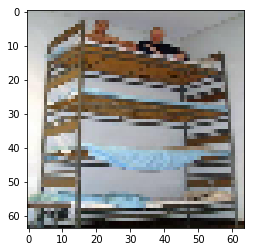

In [9]:
plt.imshow(X_images[0])

In [12]:
#GENERATE IMAGES ON 64*64 X_images

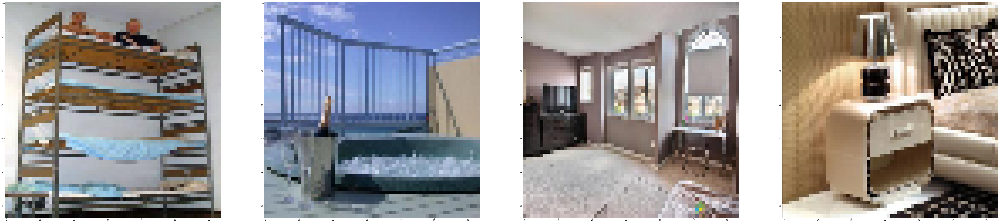

In [157]:
fix, ax = plt.subplots(1,4, figsize=(100,100))
for i in zip(range(4)):
    ax[i].imshow(X_images[i])
plt.show()

In [14]:
#READ COMPLETE TUTORIAL FIRST,BLOG POST AND VIDEO

In [ ]:
X_images.shape[0]

In [10]:
X_train_reshaped=np.empty((X_images.shape[0],3,img_height,img_width),dtype='float32')
for j,l in enumerate(X_images):
    k=np.rollaxis(l,2)
    #print (k.shape)
    X_train_reshaped[j]=k
print (X_train_reshaped.shape)

(151573, 3, 64, 64)


In [11]:
np.save('reshaped_image_array.npy',X_train_reshaped)

In [12]:
%time X_train_reshaped=np.load('reshaped_image_array.npy')

Wall time: 49.3 s


In [144]:
%pwd

'C:\\Users\\Srinjay\\Desktop\\GAN'

In [175]:
path='C://Users//Srinjay//Desktop//GAN//data0//lsun//trial'
data_set = dsets.ImageFolder(root=path,
                           transform=transforms.Compose([
                               transforms.Resize(64),
                               transforms.CenterCrop(64),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))

In [13]:
train_set=torch.from_numpy(X_train_reshaped)
print (train_set.shape)
print (train_set.dtype)

torch.Size([151573, 3, 64, 64])
torch.float32


In [14]:
Y_real=[1 for i in range(X_train_reshaped.shape[0])]
#Y_fake=[0 for i in range(X_train_reshaped.shape[0])]

In [15]:
Y_real=[np.array(i,dtype=np.float32) for i in Y_real]
Y_real=np.array(Y_real)

In [16]:
label_set=torch.from_numpy(Y_real)

In [18]:
dataset=utils.TensorDataset(train_set)

In [177]:
bs,nw=128,4
data_loader=utils.DataLoader(dataset,batch_size=bs,num_workers=nw,shuffle=True)
data_loader_trial=utils.DataLoader(data_set,batch_size=bs,num_workers=nw,shuffle=True)

In [70]:
for i_batched,(data,label) in enumerate(data_loader):
    if (i_batched==0):
        print (sample,label)
        #print (sample)

tensor([[[[0.4930, 0.4824, 0.4329,  ..., 0.5392, 0.5657, 0.5915],
          [0.4845, 0.4809, 0.4275,  ..., 0.5573, 0.5873, 0.6072],
          [0.4643, 0.4628, 0.4275,  ..., 0.5789, 0.6050, 0.6330],
          ...,
          [0.1704, 0.1638, 0.1097,  ..., 0.4039, 0.4039, 0.4039],
          [0.1440, 0.1931, 0.0900,  ..., 0.4039, 0.4029, 0.4078],
          [0.1041, 0.1575, 0.1634,  ..., 0.3976, 0.3970, 0.4000]],

         [[0.3748, 0.3608, 0.3153,  ..., 0.5706, 0.6010, 0.6268],
          [0.3662, 0.3593, 0.3098,  ..., 0.5887, 0.6187, 0.6386],
          [0.3461, 0.3412, 0.3098,  ..., 0.6087, 0.6363, 0.6644],
          ...,
          [0.1077, 0.1010, 0.0470,  ..., 0.3333, 0.3333, 0.3294],
          [0.0812, 0.1303, 0.0303,  ..., 0.3333, 0.3323, 0.3333],
          [0.0414, 0.0948, 0.1006,  ..., 0.3270, 0.3264, 0.3255]],

         [[0.2825, 0.2824, 0.2055,  ..., 0.5148, 0.5344, 0.5602],
          [0.2740, 0.2809, 0.2000,  ..., 0.5377, 0.5599, 0.5798],
          [0.2538, 0.2628, 0.2000,  ..., 0

In [21]:
batch_images=[]
for i in range(32):
    batch_images.append(sample[0][i])

IndexError: index 5 is out of bounds for axis 1 with size 5

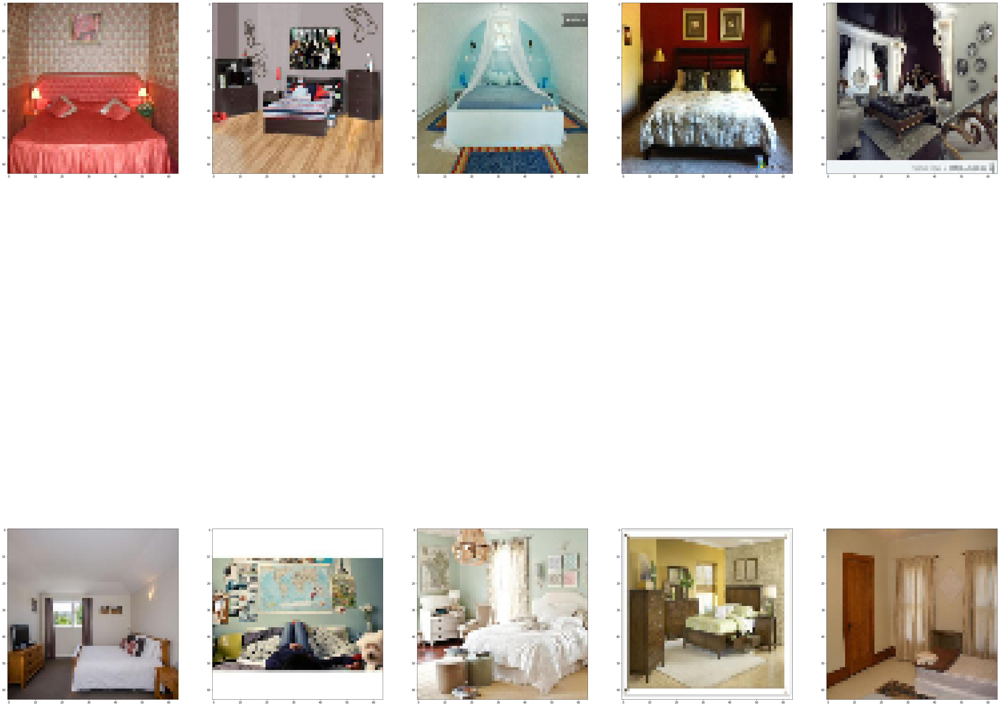

In [22]:
fix, ax = plt.subplots(2,5, figsize=(64,64))
for i in range(10):
    ax[0,i].imshow(np.transpose(batch_images[i].numpy(),(1,2,0)))
    ax[1,i-5].imshow(np.transpose(batch_images[i+5].numpy(),(1,2,0)))

In [178]:
device=torch.device("cuda:0" if (torch.cuda.is_available()) else "cpu")
device

device(type='cuda', index=0)

In [179]:
def weights_init(model_obj):
    classname = model_obj.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(model_obj.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(model_obj.weight.data, 1.0, 0.02)
        nn.init.constant_(model_obj.bias.data, 0)

In [180]:
class generator_block(nn.Module):
    def __init__(self,nz_size,n_fmaps,kernel_size,stride,padding,bias=False):
        super().__init__()
        self.conv=nn.ConvTranspose2d(nz_size,n_fmaps,kernel_size,stride,padding,bias=False)
        self.bn=nn.BatchNorm2d(n_fmaps)
        self.relu=nn.ReLU(inplace=True)
    def forward(self, x):
        x = self.relu(self.conv(x))
        return self.bn(x) if self.bn else x

In [181]:
nz_size,n_fmaps=100,64
class generator(nn.Module):
    def __init__(self):
        super(generator,self).__init__()
        self.gen_model=nn.Sequential(
            generator_block(nz_size, n_fmaps*8,4,1,0,bias=False),
            generator_block(n_fmaps*8, n_fmaps*4,4,2,1,bias=False),
            generator_block(n_fmaps*4,n_fmaps*2,4,2,1,bias=False),
            generator_block(n_fmaps*2,n_fmaps,4,2,1,bias=False),
            nn.ConvTranspose2d(n_fmaps,3,4,2,1,bias=False),
            nn.Tanh())
    def forward(self,input):
        return (self.gen_model(input))

In [182]:
netG = generator()

In [183]:
netG.apply(weights_init)

generator(
  (gen_model): Sequential(
    (0): generator_block(
      (conv): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
      (bn): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace)
    )
    (1): generator_block(
      (conv): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (bn): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace)
    )
    (2): generator_block(
      (conv): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (bn): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace)
    )
    (3): generator_block(
      (conv): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (bn): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_st

In [184]:
for param in netG.parameters():
    print (np.std(param.data.numpy()),np.mean(param.data.numpy()))

0.019975694 2.3009032e-05
0.019236134 0.99979305
0.0 0.0
0.019996842 -8.591723e-06
0.021052327 1.0002258
0.0 0.0
0.020015663 2.0593005e-05
0.019524522 0.99948364
0.0 0.0
0.019952187 8.7086126e-05
0.016240636 1.0017494
0.0 0.0
0.02041764 -0.0002539823


In [185]:
class discriminator_block(nn.Module):
    def __init__(self,nd_size,nd_fmaps,kernel_size,stride,padding,bias=False):
        super().__init__()
        self.conv=nn.Conv2d(nd_size,nd_fmaps,kernel_size,stride,padding,bias=False)
        self.bn=nn.BatchNorm2d(nd_fmaps)
        self.relu=nn.LeakyReLU(0.2,inplace=True)
    def forward(self, x):
        x = self.relu(self.conv(x))
        return self.bn(x) if self.bn else x

In [186]:
nd_fmaps=64
class discriminator(nn.Module):
    def __init__(self):
        super().__init__()
        self.disc_model=nn.Sequential(
            nn.Conv2d(3, nd_fmaps, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            discriminator_block(nd_fmaps, nd_fmaps * 2, 4, 2, 1, bias=False),
            discriminator_block(nd_fmaps * 2, nd_fmaps * 4, 4, 2, 1, bias=False),
            discriminator_block(nd_fmaps * 4, nd_fmaps * 8, 4, 2, 1, bias=False),
            nn.Conv2d(nd_fmaps*8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid())
    def forward(self,input):
        return (self.disc_model(input))

In [187]:
netD = discriminator()

In [188]:
netD.apply(weights_initialize)

discriminator(
  (disc_model): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace)
    (2): discriminator_block(
      (conv): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (bn): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): LeakyReLU(negative_slope=0.2, inplace)
    )
    (3): discriminator_block(
      (conv): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (bn): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): LeakyReLU(negative_slope=0.2, inplace)
    )
    (4): discriminator_block(
      (conv): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (bn): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): LeakyReLU(negative_slope=0.2, inplace)
  

In [189]:
for param in netD.parameters():
    print (np.mean(param.data.numpy()),np.std(param.data.numpy()))

-0.00031214254 0.2013377
-0.00040031815 0.19965996
1.0115905 0.19272397
0.0 0.0
8.854468e-05 0.20021506
1.0038174 0.19427772
0.0 0.0
-6.0176215e-05 0.20005502
1.0062782 0.20450182
0.0 0.0
0.0006688398 0.1969843


In [190]:
netG=netG.cuda()
netD=netD.cuda()

In [191]:
"""this function is used to sample a latent vectors of zeros from a normal distribution to monitor the  
training of he generator,In the training loop input this noise periodically to mintor the progress of the generator 
to produce images from the vector"""

fixed_noise = torch.randn(64, 100, 1, 1, device=device)

In [192]:
lr=0.0002
beta=0.0002
real_label=1
fake_label=0
criterion=nn.BCELoss()
optimizerG=optim.Adam(netG.parameters(),lr=lr,betas=(beta,0.99))
optimizerD=optim.Adam(netD.parameters(),lr=lr,betas=(beta,0.99))

In [193]:
print (fixed_noise.shape)
print (fixed_noise.dtype)

torch.Size([64, 100, 1, 1])
torch.float32


In [194]:
print (np.mean(fixed_noise.cpu().numpy()))
print (np.std(fixed_noise.cpu().numpy()))

0.024741571
0.99339354


In [201]:
img_list = []
G_losses = []
D_losses = []
iters = 0
n_epochs=5
for epoch in range(n_epochs):
    for i,(data) in enumerate(data_loader_trial,0):
        #real_images
        netD.zero_grad()
        real_img = data[0].cuda()
        batch_size=real_img.size(0)
        labels = torch.full((batch_size,), real_label, device=device)
        op=netD(real_img).view(-1)
        loss_D_real=criterion(op,labels)
        loss_D_real.backward()
        D_x=op.mean().item()#should converge to 0.5(starting from 1)
        
        #fake images
        noise = torch.randn(batch_size, 100, 1, 1,device=device)
        fake=netG(noise)
        labels.fill_(fake_label)
        op_fake=netD(fake.detach()).view(-1)
        loss_D_fake=criterion(op_fake,labels)
        loss_D_fake.backward()
        D_G_z=op_fake.mean().item()#should converge to 0.5(starting from 0)
        tot_loss_D=loss_D_real + loss_D_fake
        optimizerD.step()
        
        #generator
        netG.zero_grad()
        labels.fill_(real_label)  
        output = netD(fake).view(-1)
        loss_G = criterion(output, labels)
        loss_G.backward()
        D_G_z2 = output.mean().item()
        optimizerG.step()
        
        
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, n_epochs, i, len(data_loader),
                     tot_loss_D.item(), loss_G.item(), D_x, D_G_z, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(loss_G.item())
        D_losses.append(tot_loss_D.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == n_epochs-1) and (i == len(data_loader)-1)):
            with torch.no_grad():
                fake=netG(fixed_noise)
                fake=fake.detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1       

[0/5][0/2369]	Loss_D: 1.6238	Loss_G: 0.7007	D(x): 0.4468	D(G(z)): 0.4492 / 0.5283
[0/5][50/2369]	Loss_D: 1.5591	Loss_G: 0.8028	D(x): 0.5025	D(G(z)): 0.5149 / 0.4957
[0/5][100/2369]	Loss_D: 1.5376	Loss_G: 0.7180	D(x): 0.4485	D(G(z)): 0.4604 / 0.5164
[0/5][150/2369]	Loss_D: 1.3943	Loss_G: 0.8378	D(x): 0.5395	D(G(z)): 0.5172 / 0.4510
[0/5][200/2369]	Loss_D: 1.5600	Loss_G: 0.7845	D(x): 0.4936	D(G(z)): 0.4953 / 0.5049
[0/5][250/2369]	Loss_D: 1.4677	Loss_G: 0.6910	D(x): 0.4727	D(G(z)): 0.4849 / 0.5214
[0/5][300/2369]	Loss_D: 1.5640	Loss_G: 0.6723	D(x): 0.4393	D(G(z)): 0.4364 / 0.5594
[0/5][350/2369]	Loss_D: 1.5248	Loss_G: 0.8671	D(x): 0.5198	D(G(z)): 0.5148 / 0.4640
[0/5][400/2369]	Loss_D: 1.5398	Loss_G: 0.8452	D(x): 0.5001	D(G(z)): 0.4891 / 0.4909
[0/5][450/2369]	Loss_D: 1.5668	Loss_G: 0.9639	D(x): 0.5635	D(G(z)): 0.5880 / 0.4043
[0/5][500/2369]	Loss_D: 1.6177	Loss_G: 0.7545	D(x): 0.4571	D(G(z)): 0.4569 / 0.5212
[0/5][550/2369]	Loss_D: 1.5294	Loss_G: 0.6511	D(x): 0.4245	D(G(z)): 0.4252 / 0.

[2/5][0/2369]	Loss_D: 1.5578	Loss_G: 0.8807	D(x): 0.4990	D(G(z)): 0.4921 / 0.4703
[2/5][50/2369]	Loss_D: 1.5760	Loss_G: 0.8916	D(x): 0.4984	D(G(z)): 0.4867 / 0.4508
[2/5][100/2369]	Loss_D: 1.5873	Loss_G: 0.8808	D(x): 0.5553	D(G(z)): 0.5774 / 0.4430
[2/5][150/2369]	Loss_D: 1.6217	Loss_G: 0.6738	D(x): 0.4466	D(G(z)): 0.4521 / 0.5711
[2/5][200/2369]	Loss_D: 1.5056	Loss_G: 0.7233	D(x): 0.4399	D(G(z)): 0.4363 / 0.5196
[2/5][250/2369]	Loss_D: 1.4628	Loss_G: 0.8998	D(x): 0.5489	D(G(z)): 0.5288 / 0.4383
[2/5][300/2369]	Loss_D: 1.5128	Loss_G: 0.9260	D(x): 0.5422	D(G(z)): 0.5474 / 0.4219
[2/5][350/2369]	Loss_D: 1.5151	Loss_G: 0.7356	D(x): 0.4652	D(G(z)): 0.4749 / 0.5119
[2/5][400/2369]	Loss_D: 1.5433	Loss_G: 0.8365	D(x): 0.4766	D(G(z)): 0.4585 / 0.4860
[2/5][450/2369]	Loss_D: 1.5571	Loss_G: 0.8667	D(x): 0.5424	D(G(z)): 0.5460 / 0.4667
[2/5][500/2369]	Loss_D: 1.5280	Loss_G: 0.7401	D(x): 0.4730	D(G(z)): 0.4771 / 0.5148
[2/5][550/2369]	Loss_D: 1.5116	Loss_G: 0.8476	D(x): 0.5113	D(G(z)): 0.4963 / 0.

[4/5][0/2369]	Loss_D: 1.5184	Loss_G: 0.8747	D(x): 0.5400	D(G(z)): 0.5364 / 0.4407
[4/5][50/2369]	Loss_D: 1.5573	Loss_G: 0.8338	D(x): 0.4933	D(G(z)): 0.4907 / 0.4810
[4/5][100/2369]	Loss_D: 1.4740	Loss_G: 0.7063	D(x): 0.4567	D(G(z)): 0.4353 / 0.5144
[4/5][150/2369]	Loss_D: 1.5473	Loss_G: 0.5834	D(x): 0.4052	D(G(z)): 0.4190 / 0.5782
[4/5][200/2369]	Loss_D: 1.5090	Loss_G: 0.7062	D(x): 0.4709	D(G(z)): 0.4577 / 0.5192
[4/5][250/2369]	Loss_D: 1.5004	Loss_G: 0.8863	D(x): 0.5539	D(G(z)): 0.5385 / 0.4509
[4/5][300/2369]	Loss_D: 1.5134	Loss_G: 0.8442	D(x): 0.5029	D(G(z)): 0.5005 / 0.4700
[4/5][350/2369]	Loss_D: 1.4552	Loss_G: 1.0144	D(x): 0.5723	D(G(z)): 0.5716 / 0.3847
[4/5][400/2369]	Loss_D: 1.4476	Loss_G: 0.9062	D(x): 0.5717	D(G(z)): 0.5613 / 0.4226
[4/5][450/2369]	Loss_D: 1.4514	Loss_G: 0.7509	D(x): 0.5061	D(G(z)): 0.4953 / 0.4922
[4/5][500/2369]	Loss_D: 1.4438	Loss_G: 0.7308	D(x): 0.4828	D(G(z)): 0.4654 / 0.5030
[4/5][550/2369]	Loss_D: 1.5096	Loss_G: 0.7993	D(x): 0.4567	D(G(z)): 0.4649 / 0.

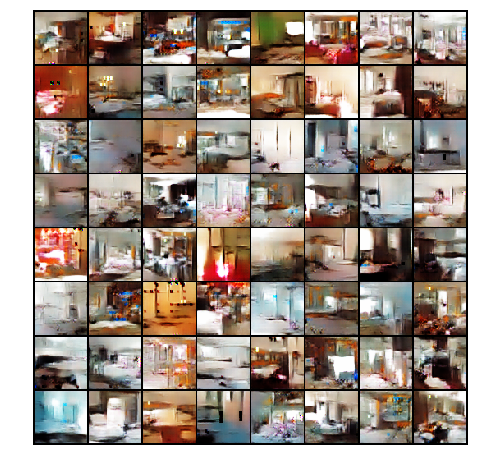

In [202]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
display = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(display.to_jshtml())